# UMAP plot colored by annotation and gene of interest

## Import statements

In [1]:
import os,sys
import datetime

In [2]:
import scanpy as sc
sc.logging.print_versions()
sc.logging.print_memory_usage()
sc.settings.verbosity = 2

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.7 numpy==1.15.4 scipy==1.3.1 pandas==0.23.4 scikit-learn==0.20.1 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1
Memory usage: current 0.20 GB, difference +0.20 GB


In [3]:
## This cell is run once to download my custom functions and import statements from github
#
#!git clone --depth=1 https://github.com/rapolaszilionis/utility_functions
#    
## github doesn't seem to have an option to download a specific version of the repo from the history.
## So I download my utility functions and save the download time by appending it to the directory name.
## These utility functions to be shared together with the notebook.
#
#toappend = datetime.datetime.now().strftime('%y%m%d_%Hh%M')
#newname = "utility_functions_%s"%toappend
#print(newname)
#
#
## rename the py file with utility functions
#os.rename("utility_functions",newname)

In [4]:
# add the utility function folder to PATH
sys.path.append(os.path.abspath("utility_functions_210525_14h42/"))

from rz_import_statements import *
import rz_functions as rz
import rz_fig_params # this adjust mpl.rcParams, almost nothing to import, import after scanpy to overwrite rc.Params
import rz_utility_spring as srz

python version: 3.6.7


## Functions

### For coloring by gene expression

In [5]:
def spring_like(
        genename,
        expression,
        x,y,
        box = [0,0,1,1],
        s = 5,
        pctilemax = 99.5,
        vmax=None,
        w = 3,
        h = 3,
        comment = '',
        pad = 0,
        ftype = 'pdf',
        dpi = 1200.,
        show_cbar=False,
        save=True,
        lims = [],
        show=True,
        printlims=False,
        outputdir='outputs/spring_like/'
        ):
    
    """Plot SPRING like gene expression.
    expression - vector with expression values
    x,y - coordinates, same shape as expression
    box - select how to crop the figures [x0,y0,x1,y1], where no cropping is [0,1,0,1]
    lims - is specified, will ignore "box", and use absolute x,y limit values, e.g. lims = [-2000,1000,-100,1500]
    vmax - value to saturate at, will overwrite the pctilemax argument
    """
    
    
    order = np.argsort(expression)
    expression = expression[order]
    
    # get selected percentile within the selected cells only
    if vmax is None:
        vmax = np.percentile(expression,pctilemax)
        
    else:
        pctilemax=0
    print(vmax)
    vmin = 0
    
    if vmin==vmax:
        expression = '#00ff00'
    
    x = x[order]
    y = y[order]
    
    a,fig,gs=rz.startfig(w,h,frameon=False)
    
    a.set_xticks([])
    a.set_yticks([])
    
    scatter = a.scatter(x,y,lw=0,s=s,c=expression,cmap=rz.custom_colormap(['#000000','#00ff00']),vmax=vmax,vmin=vmin)
    
    # adjust the limits of the plot
    # get current limits
    xlim0 = a.get_xlim()[0]
    xlim1 = a.get_xlim()[1]
    ylim0 = a.get_ylim()[0]
    ylim1 = a.get_ylim()[1]
    
    if printlims:
        print(xlim0,xlim1,ylim0,ylim1,"x1x2y1y2")
    
    # get differences:
    dx = xlim1-xlim0
    dy = ylim1-ylim0
    
    # apply the cropping:
    xmin = xlim0+box[0]*dx
    xmax = xlim1-(1-box[2])*dx
    
    ymin = ylim0+box[1]*dy
    ymax = ylim1-(1-box[3])*dy
    
    if len(lims)==4:
        [xmin,ymin,xmax,ymax] = lims
    a.set_xlim(xmin,xmax)
    a.set_ylim(ymin,ymax)
    
    if show_cbar:
        cbar = plt.colorbar(scatter,orientation='horizontal')
        cbar.outline.set_visible(False)
        cbar.set_ticks([0,vmax])
        cbar.ax.set_xticklabels(['0th','>%0.1fth'%pctilemax])
    
    gs.tight_layout(fig,pad=pad)
    
    
    if save:
        plt.savefig(outputdir+'%s_scatter_%s_%.2f_pctile.%s'%(genename,comment,pctilemax,ftype),dpi=dpi)
    
    if show:
        plt.show()
    else:
        plt.close()

## Load data

In [6]:
adata = sc.read_h5ad('backups/mito_total_counts_filt_raw_32415x36601_210622_20h17.h5ad')

In [7]:
# load obs with classifier results
adata.obs = rz.load_df('backups/obs_info_32415x18_211010_11h51.npz')

In [8]:
# normalize
sc.pp.normalize_per_cell(adata,counts_per_cell_after=1e4)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


## Load color dictionary used in SPRING explorer

In [9]:
path1 = "/Users/rapolaszilionis/Google Drive/DG/tmp_for_S3/20210616_RZ_macrophage_fastq_and_counts/quick_analysis_spring_plot/SPRING_dev-master/data/"
project_dir = path1+'/mamito/'
plot_name = 'all_above_900_UMAP_no_cc_2000/'

In [10]:
# load current color dictionary
cg0 = srz.read_cell_groupings(project_dir+plot_name+'/categorical_coloring_data.json')

# color dictionary
cdd = {key:value['label_colors'] for key,value in cg0.items()}

In [12]:
cdd['phase']

{'G0': '#008080', 'G1S': '#FFAE00', 'G2M': '#FF0000'}

In [13]:
cdd['population']

{'AI': '#5eff0d',
 'AII': '#49a300',
 'Dead': '#ff9900',
 'HA': '#114a0e',
 'IR': '#ff0000',
 'MA': '#00007f',
 'PA': '#fff757',
 'RS': '#0088ff',
 'SS': '#0cf4e8'}

In [14]:
cdd['condition']

{'Control': '#ffe500', 'KIPyV VLPs': '#00d4ff', 'MCPyV VLPs': '#00007f'}

## Plot colored by annotation

In [15]:
colorby = 'population'
cmask = (~adata.obs[colorby].isna()).values
x = adata.obs['x'][cmask].values
y = adata.obs['y'][cmask].values
colors = [cdd[colorby][i] for i in adata.obs[colorby][cmask]]

-1141.1347767542413 724.9578267542413 -1084.8161371821602 1182.74493718216


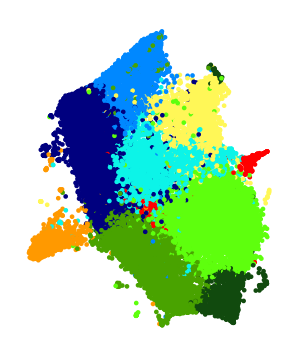

In [16]:
a,fig,gs = rz.startfig(5,6,frameon=False)
a.scatter(x,y,color=colors,lw=0,s=5)

a.set_xticks([])
a.set_yticks([])

x1 = a.get_xlim()[0]
x2 = a.get_xlim()[1]
y1 = a.get_ylim()[0]
y2 = a.get_ylim()[1]
print(x1,x2,y1,y2)

gs.tight_layout(fig)

plt.savefig('postannotoutputs/umap_pop_ALL.png',dpi=600)
plt.savefig('postannotoutputs/umap_pop_ALL.pdf')
plt.show()

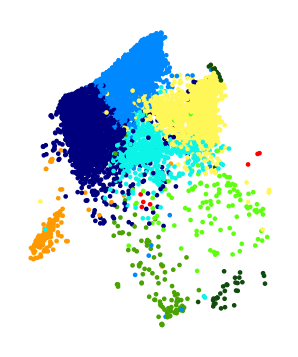

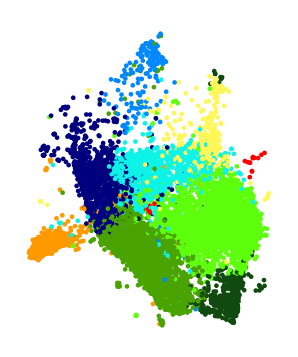

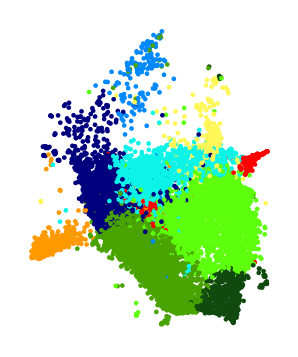

In [17]:
# same but split by condition
for cond in adata.obs['condition'][cmask].unique():
    condmask = adata.obs['condition'][cmask] == cond
    condmask = condmask.values
    fname = "postannotoutputs/umap_pop_%s"%(cond.replace(' ','_'))
    
    a,fig,gs = rz.startfig(5,6,frameon=False)
    a.scatter(x[condmask],
              y[condmask],
              color=np.array(colors)[condmask],
              lw=0,s=5)
    
    a.set_xticks([])
    a.set_yticks([])
    a.set_xlim([x1,x2])
    a.set_ylim([y1,y2])
    
    gs.tight_layout(fig)
    
    plt.savefig(fname+'.png',dpi=600)
    plt.savefig(fname+'.pdf')
    plt.show()

In [18]:
!open postannotoutputs/

### Plot each condition separately

Control
postannotoutputs/umap_condition_Control


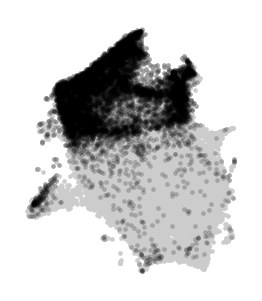

KIPyV VLPs
postannotoutputs/umap_condition_KIPyV VLPs


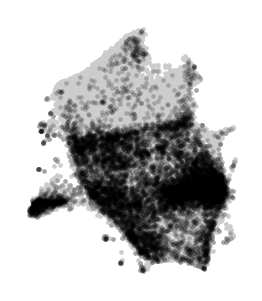

MCPyV VLPs
postannotoutputs/umap_condition_MCPyV VLPs


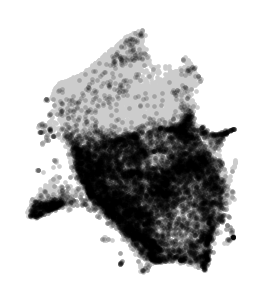

In [19]:
splitby = 'condition'

for i in adata.obs[splitby].unique():
    print(i)
    
    # gray plots
    a,fig,gs = rz.startfig(5,6,frameon=False)
    a.scatter(x,y,color='0.8',lw=0,s=5)
    
    # black plots
    m = adata.obs[splitby] == i
    m = m.values
    a.scatter(x[m],y[m],color='0',lw=0,s=5,alpha=0.2)
    
    # no ticks
    a.set_xticks([])
    a.set_yticks([])
    
    # file name
    fname = 'postannotoutputs/umap_%s_%s'%(splitby,i)
    plt.savefig(fname+'.png',dpi=600)
    plt.savefig(fname+'.pdf')
    print(fname)
    plt.show()

### Piechart of cell numbers per population

/Users/rapolaszilionis/anaconda3/lib/python3.6/site-packages/matplotlib/font_manager.py:1241: UserWarning: findfont: Font family ['Myriad Pro'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


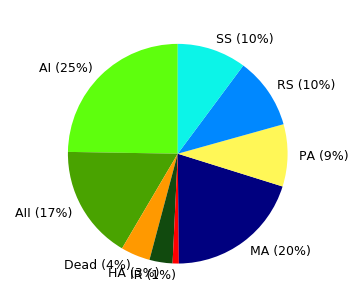

In [20]:
colorby = 'population'
cmask = (~adata.obs[colorby].isna()).values
cdict = cdd[colorby]

nrs = adata.obs[cmask].groupby(colorby).count().iloc[:,0]
labs = nrs.index
colors = [cdict[i] for i in labs]
pcts = nrs/nrs.sum()*100.

newlabs = [i+" (%.0f%%)"%j for i,j in zip(labs,pcts)]

a,fig,gs = rz.startfig(6,6)
a.pie(nrs,labels = newlabs,colors=colors,startangle=90);

gs.tight_layout(fig)
plt.savefig('postannotoutputs/pie_populations.pdf')

In [21]:
# record the population order
order = labs

### Piechart for each condition separately

Control
MCPyV VLPs ['AI (1%)', 'AII (1%)', 'Dead (2%)', 'HA (1%)', 'IR (0%)', 'MA (36%)', 'PA (22%)', 'RS (30%)', 'SS (7%)']
KIPyV VLPs
MCPyV VLPs ['AI (43%)', 'AII (20%)', 'Dead (6%)', 'HA (3%)', 'IR (0%)', 'MA (11%)', 'PA (3%)', 'RS (2%)', 'SS (11%)']
MCPyV VLPs
MCPyV VLPs ['AI (28%)', 'AII (27%)', 'Dead (5%)', 'HA (6%)', 'IR (2%)', 'MA (15%)', 'PA (4%)', 'RS (1%)', 'SS (13%)']


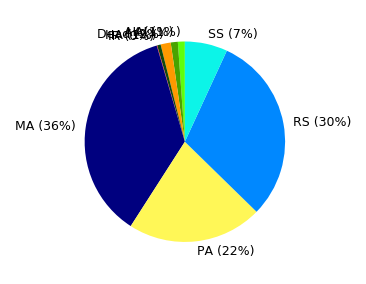

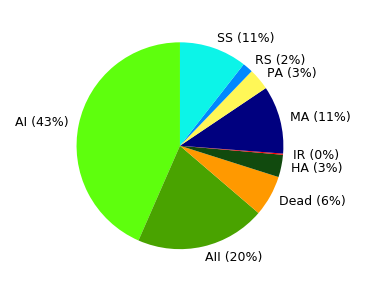

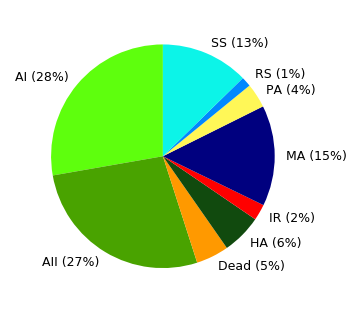

In [22]:
colorby = 'population'
cmask = (~adata.obs[colorby].isna()).values
cdict = cdd[colorby]

for condition in adata.obs.condition.unique():
    
    print(condition)
    condmask = adata.obs['condition'] == condition

    nrs = adata.obs[cmask&condmask].groupby(colorby).count().iloc[:,0]
    #apply the population order from plot of all conditions together
    nrs = nrs[order]
    labs = nrs.index
    colors = [cdict[i] for i in labs]
    pcts = nrs/nrs.sum()*100.
    
    newlabs = [i+" (%.0f%%)"%j for i,j in zip(labs,pcts)]
    print(cond, newlabs)
    
    a,fig,gs = rz.startfig(6,6)
    a.pie(nrs,labels = newlabs,colors=colors,startangle=90);#,labeldistance=1.4);
    
    gs.tight_layout(fig)
    plt.savefig('postannotoutputs/pie_populations_%s.pdf'%condition)

### Plot each cell cycle phase separately

G0
postannotoutputs/umap_phase_G0


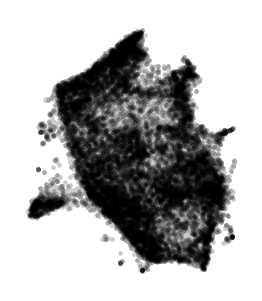

G2M
postannotoutputs/umap_phase_G2M


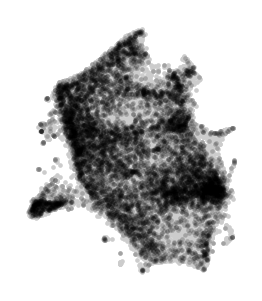

G1S
postannotoutputs/umap_phase_G1S


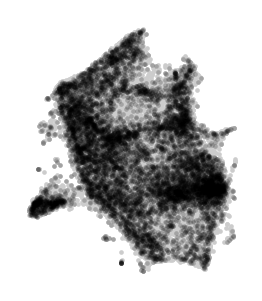

In [28]:
splitby = 'phase'

for i in adata.obs[splitby].unique():
    print(i)
    
    # gray plots
    a,fig,gs = rz.startfig(5,6,frameon=False)
    a.scatter(x,y,color='0.8',lw=0,s=5)
    
    # black plots
    m = adata.obs[splitby] == i
    m = m.values
    a.scatter(x[m],y[m],color='0',lw=0,s=5,alpha=0.2)
    
    # no ticks
    a.set_xticks([])
    a.set_yticks([])
    
    # file name
    fname = 'postannotoutputs/umap_%s_%s'%(splitby,i)
    plt.savefig(fname+'.png',dpi=600)
    plt.savefig(fname+'.pdf')
    print(fname)
    plt.show()

## Color by selected gene expression

In [29]:
tocheck = ['MT-ATP6','MT-ND1','MT-CO3',
          'CXCL8','CCL3L1','CCL3',# AI, AII
          'IL1B','CXCL1','CXCL3','CXCL8','CSTB','CCL3','CCL20','CCL4L2', # HA
          'STC1','MMP8','ATP2B1','SNX9','FTH1',#HA, AII
          'ARHGAP18',
          'TMEM158','TGM2','OXR1',
          'FN1', #
          'SPP1','CTSC','TREM2','S100A4', 'ACTB', #PA
          'CD52','LMO4','COX5B','CHI3L1', #SS
          'CXCL10','ISG15','IFITM3','IFIT1','IFI6', #IR
          'MT-CO3','MT-CYB','RPL37A','RPS23', # MA
         ]

inheat = [
'NEAT1',
'MTRNR2L12',
'MALAT1',
'MT-CO3',
'MT-ND3',
'MT-CYB',
'MT-ND2',
'MT-ND4',
'MT-ND1',
'MT-CO2',
'MTRNR2L10',
'MT-ATP6',
'MT-ATP8',
'MTRNR2L8',
'MT-ND6',
'POLR2J3',
'MT-ND4L',
'MT-ND5',
'MT-CO1',
'OGFRL1',
'FTH1',
'BEST1',
'POU2F2',
'USP53',
'SCG5',
'MTSS1',
'SNX9',
'NRG1',
'STC1',
'ATP2B1',
'RGS16',
'EBI3',
'SERPINE2',
'KYNU',
'MT2A',
'IL1RN',
'IL1B',
'MMP1',
'SOD2',
'NFKBIA',
'CCL4L2',
'CCL4',
'CCL20',
'CXCL8',
'CCL3L1',
'CCL3',
'MMP10',
'NAMPT',
'CXCL2',
'CXCL1',
'CXCL3',
'AC243829.4',
'SLC7A11',
'CD82',
'CSTB',
'SAT1',
'MMP8',
'SLC39A14',
'MMP9',
'S100A11',
'TIMP1',
'VIM',
'B2M',
'PRDX1',
'UBC',
'AC078850.1',
'FTL',
'RAB31',
'FN1',
'ARHGAP18',
'PPFIBP1',
'LIMS1',
'TMEM158',
'FAM3C',
'AP1S2',
'TPM4',
'MAP4K4',
'TGM2',
'OXR1',
'GNLY',
'RESF1',
'ASPH',
'TMTC1',
'FCER1G',
'MYL6',
'CALM2',
'DAD1',
'PINLYP',
'ANXA1',
'PPIB',
'ACTB',
'IFI30',
'S100A4',
'APOC2',
'ITM2B',
'SDC2',
'CTSC',
'TREM2',
'CAPG',
'HSP90B1',
'SPP1',
'PDIA3',
'NRGN',
'AL713998.1',
'MAP3K7CL',
'BEX3',
'MRPS6',
'CHI3L1',
'CD52',
'GDF15',
'TSC22D1',
'COX5B',
'EID1',
'RGCC',
'GAL',
'LINC02244',
'CTSB',
'LMO4',
'DPYSL2',
'LPL',
'GPC4',
'IFI6',
'RNF213',
'LY6E',
'SAMD9',
'IFITM3',
'ISG20',
'EIF2AK2',
'CXCL10',
'TNFSF13B',
'CXCL11',
'IFIT2',
'IFI44L',
'SP110',
'EPSTI1',
'SAMD9L',
'IFIT3',
'IFIT1',
'IFI44',
'ISG15',
'PLSCR1',
'GAS5',
'SNHG32',
'RPL37A',
'RPL10',
'RPS23',
'RPL36A',
'RPS8',
'RPL7',
'RPL34',
'EEF1B2',
'RPS18',
'RPS12',
'TMSB4X',
'RPS2',
'CENPF',
'ALOX5AP',
'ITM2C'
]

[i for i in tocheck if i not in inheat]

[]

116.4563478851343


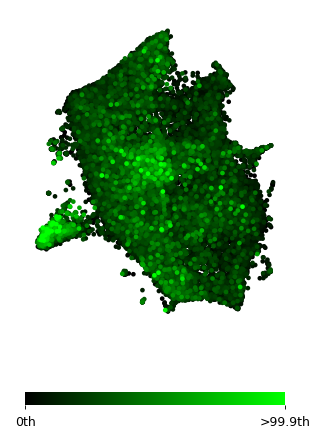

116.4563478851343
95.87251991271975


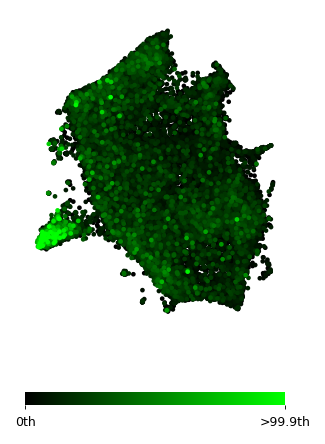

95.87251991271975
3404.0035761718827


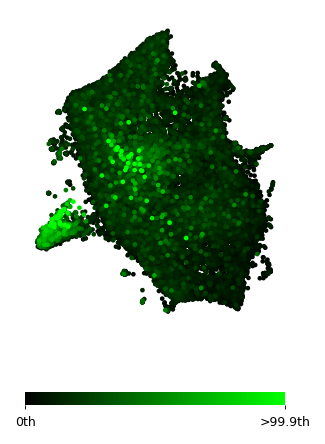

3404.0035761718827
413.7924569091803


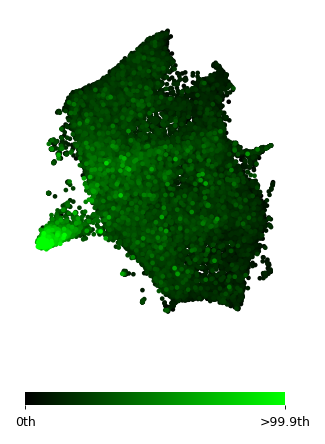

413.7924569091803
85.87089010620181


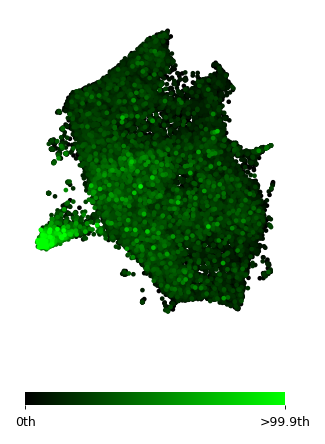

85.87089010620181
222.96735610962065


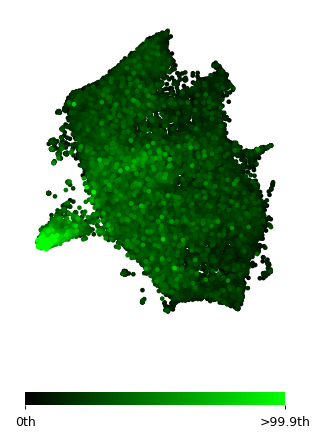

222.96735610962065
363.90238458253407


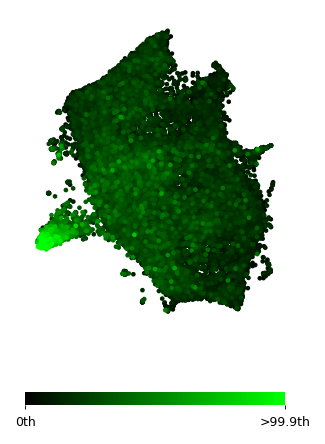

363.90238458253407
478.83231231691434


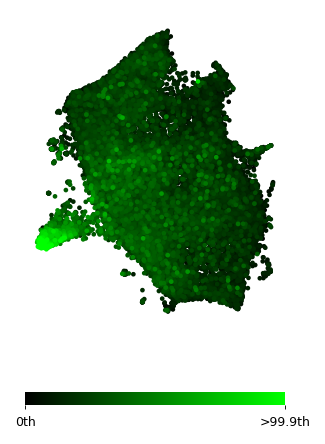

478.83231231691434
430.47700170899645


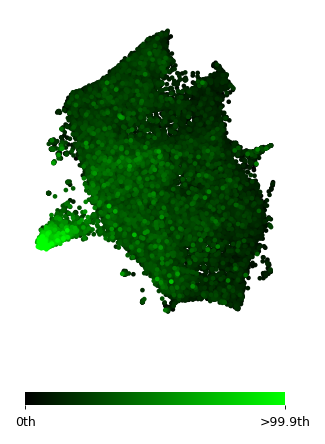

430.47700170899645
541.5723571777371


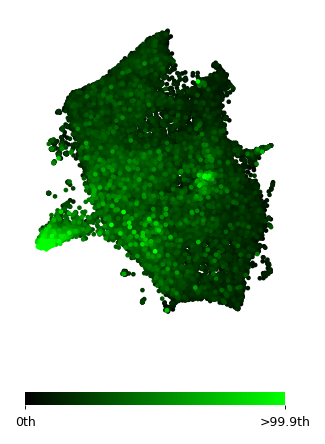

541.5723571777371
18.38294779205334


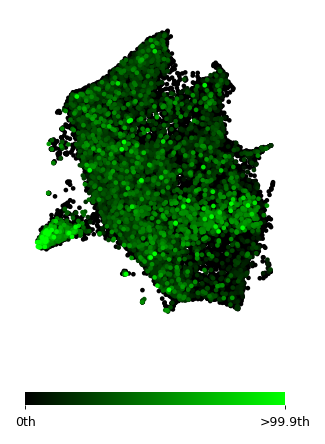

18.38294779205334
455.908005615237


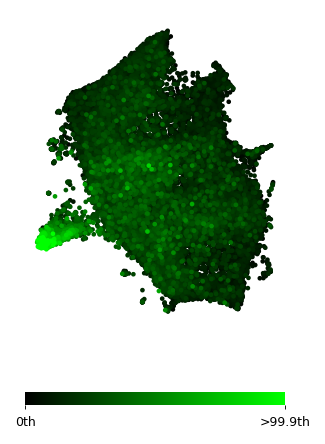

455.908005615237
20.928122135162614


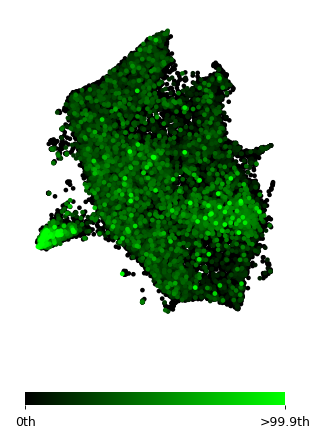

20.928122135162614
46.98068516540543


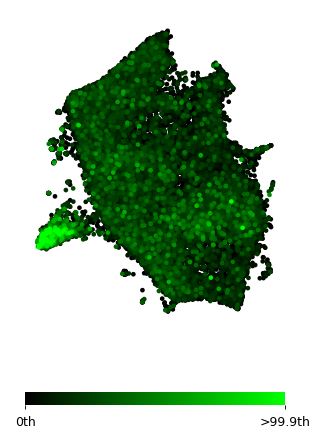

46.98068516540543
40.52437359619243


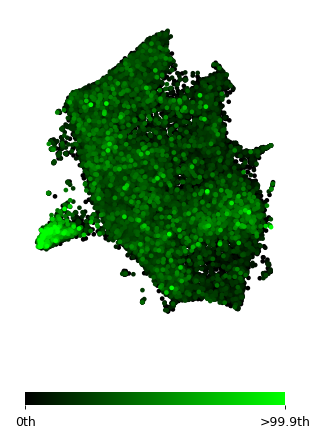

40.52437359619243
20.56737705612189


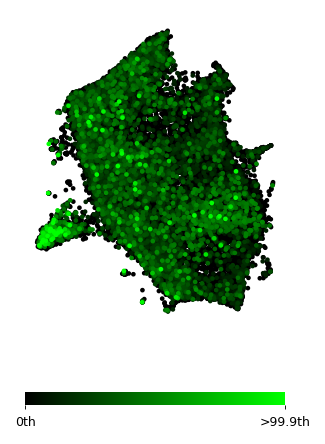

20.56737705612189
113.17908267212024


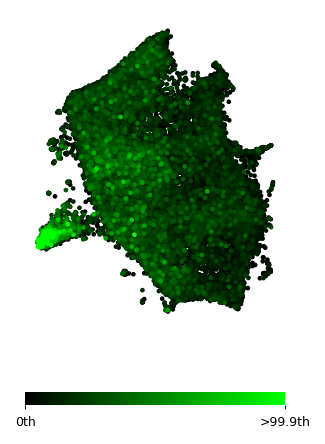

113.17908267212024
206.15420223999303


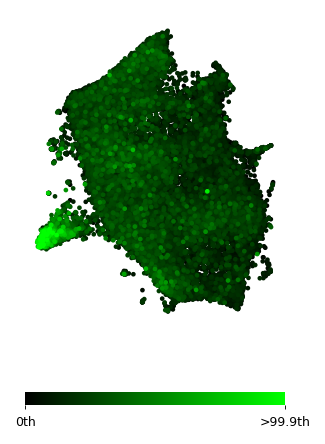

206.15420223999303
517.3543037109424


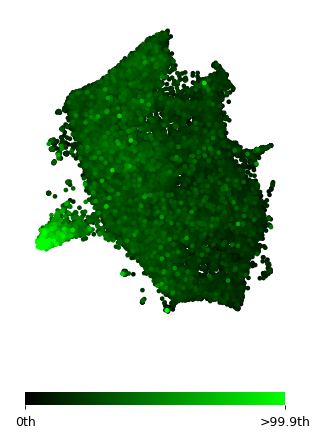

517.3543037109424
28.093294925689815


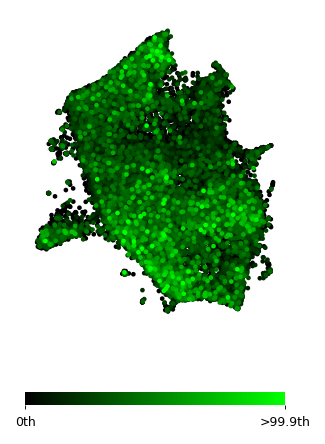

28.093294925689815
1707.007667724632


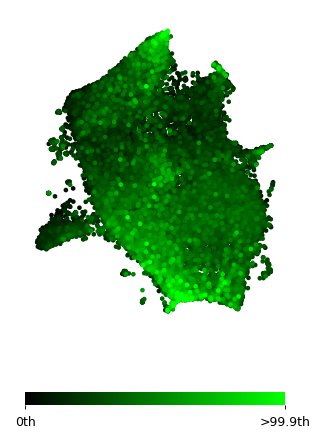

1707.007667724632
55.8096539306641


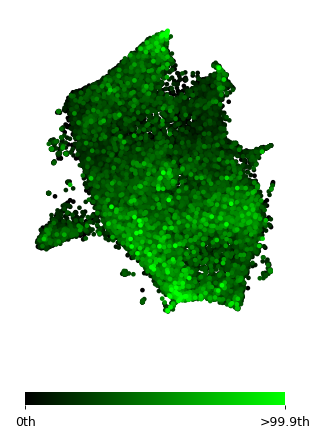

55.8096539306641
36.48836017608672


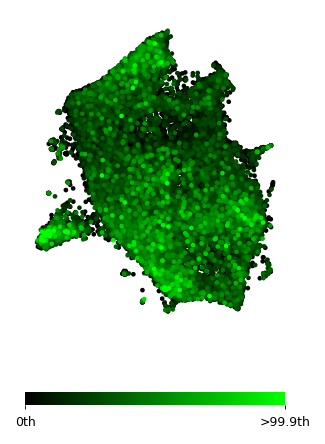

36.48836017608672
22.06833543014531


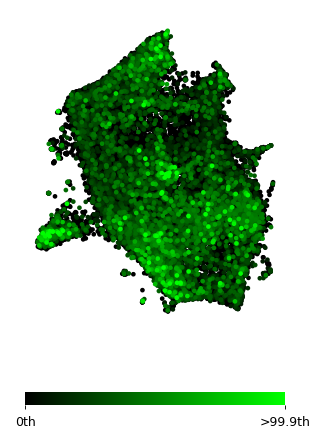

22.06833543014531
31.31373254776043


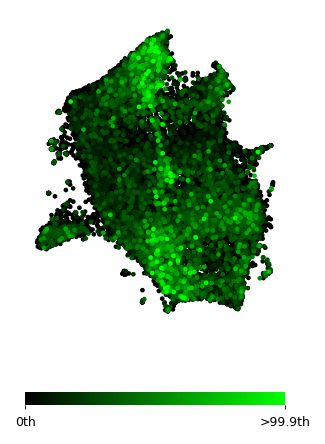

31.31373254776043
53.29415066528348


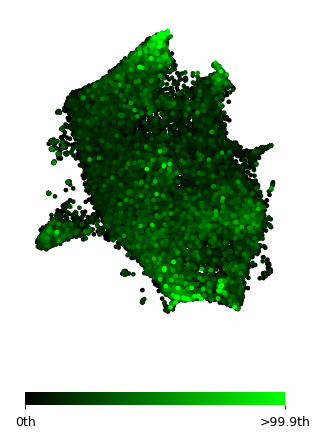

53.29415066528348
39.22514888000555


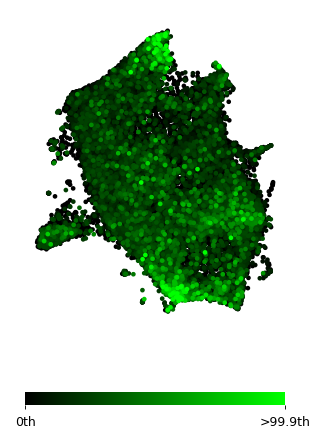

39.22514888000555
31.617987430572708


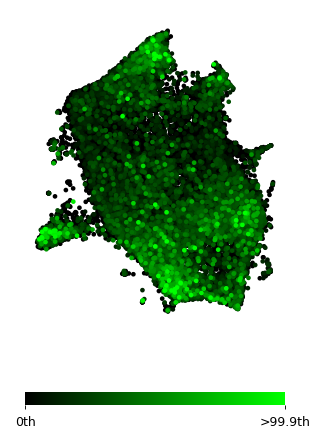

31.617987430572708
57.36653993988112


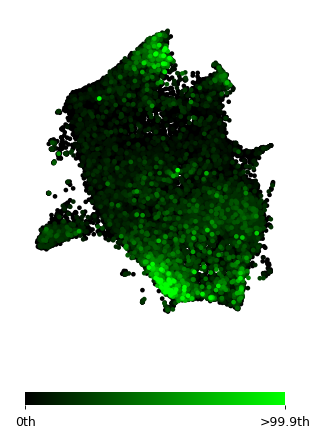

57.36653993988112
57.75462564849859


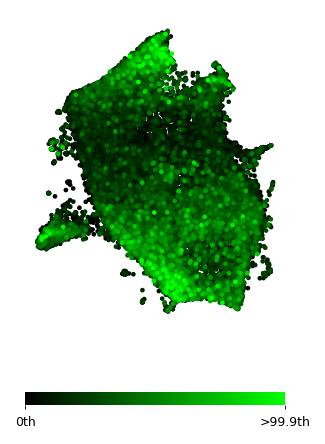

57.75462564849859
55.52338078308239


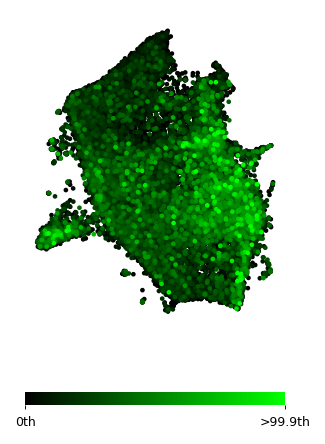

55.52338078308239
21.89588182449348


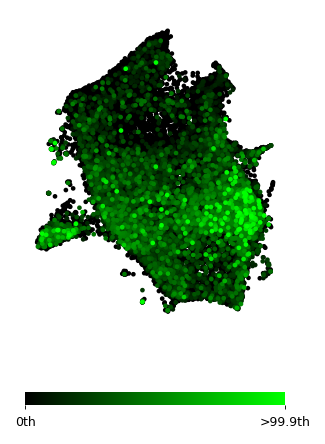

21.89588182449348
31.635212688446117


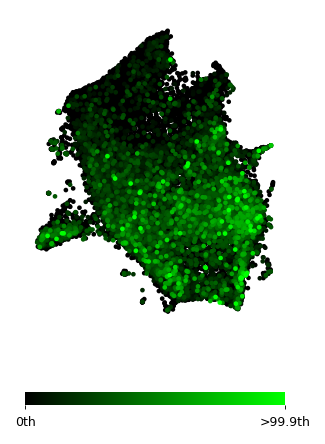

31.635212688446117
21.021349052429265


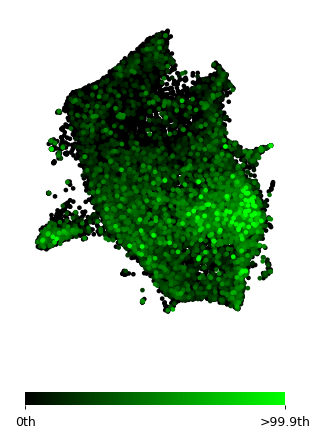

21.021349052429265
83.69727397155822


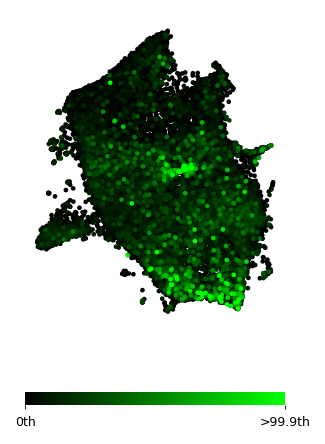

83.69727397155822
36.21528624725427


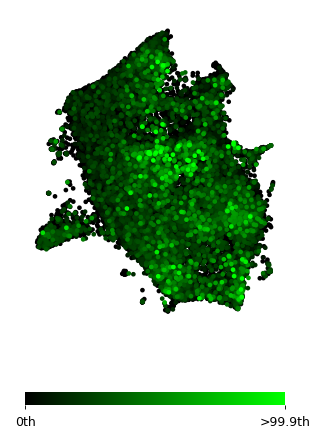

36.21528624725427
701.1031147460944


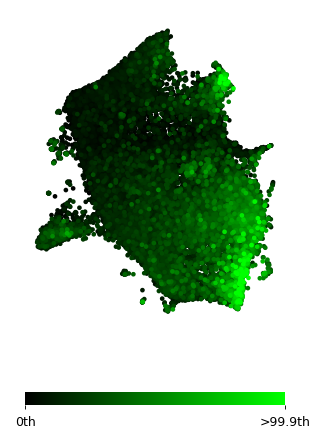

701.1031147460944
131.09834567260776


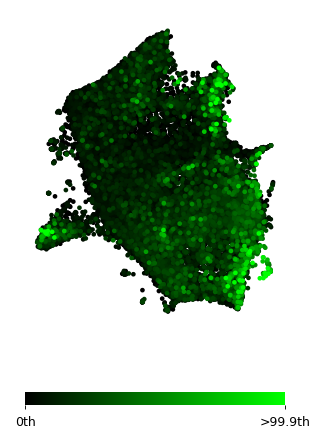

131.09834567260776
59.28386113739286


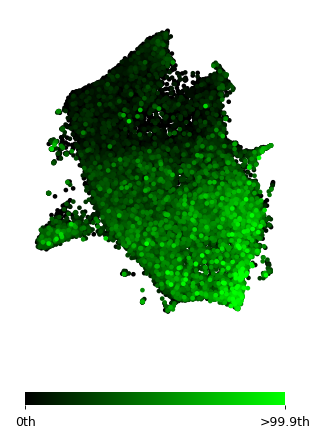

59.28386113739286
34.374688774109835


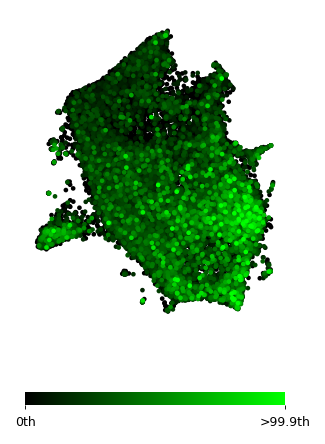

34.374688774109835
127.05099307251538


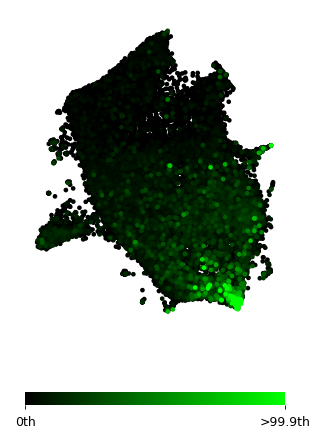

127.05099307251538
79.6547416839635


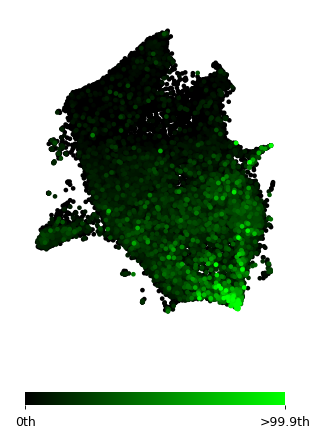

79.6547416839635
254.10845260620312


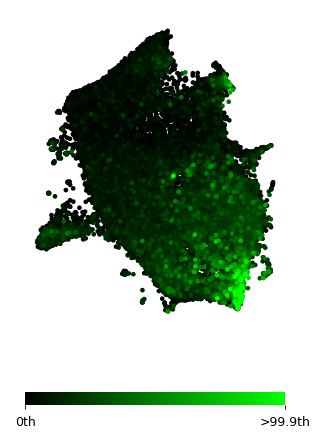

254.10845260620312
831.3523404541193


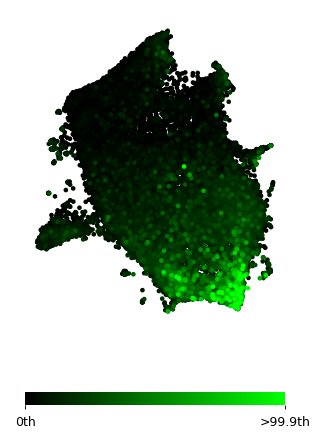

831.3523404541193
835.5929664306722


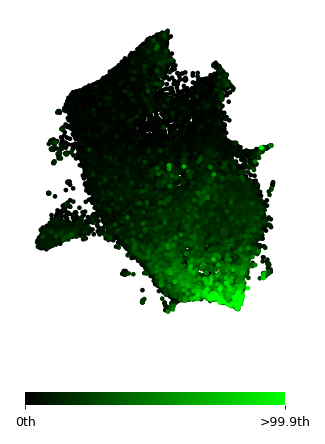

835.5929664306722
583.146654418968


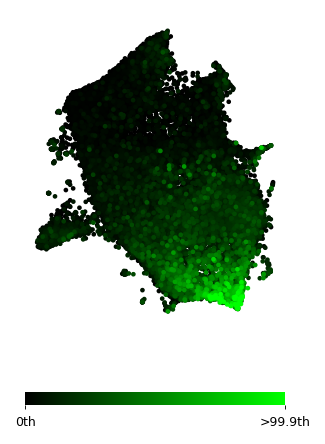

583.146654418968
20.96092761612197


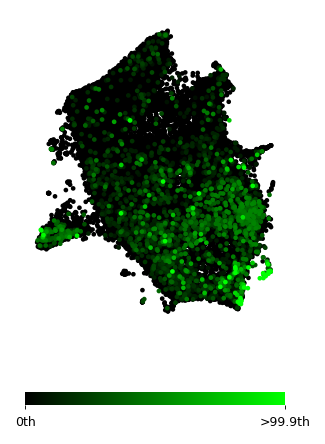

20.96092761612197
25.687202556611204


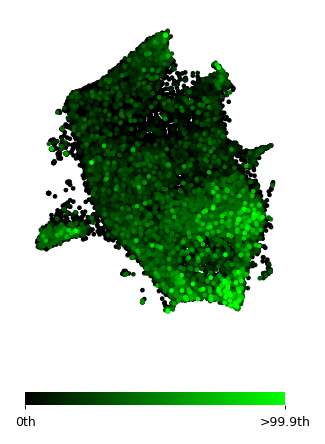

25.687202556611204
25.055758045196924


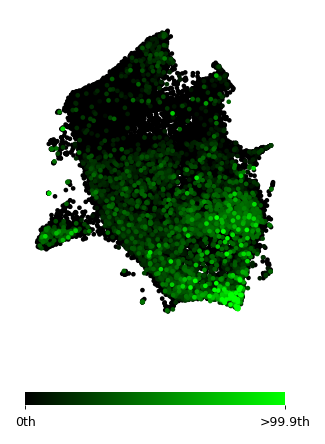

25.055758045196924
37.6647834777832


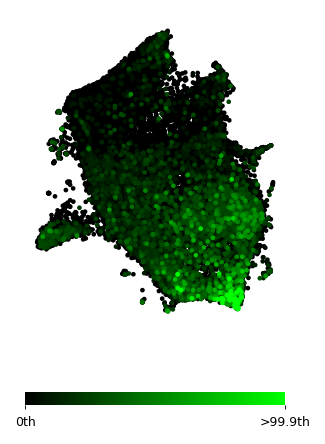

37.6647834777832
79.9995592956608


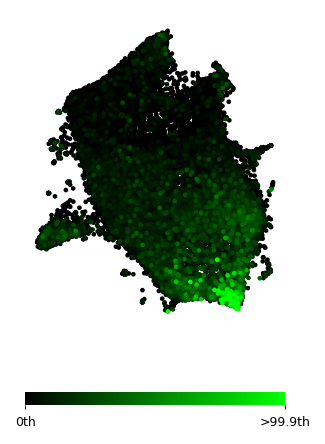

79.9995592956608
18.878303760528794


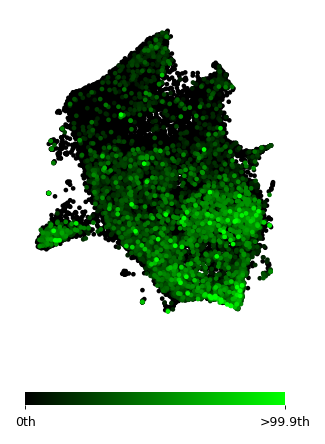

18.878303760528794
17.767471412658878


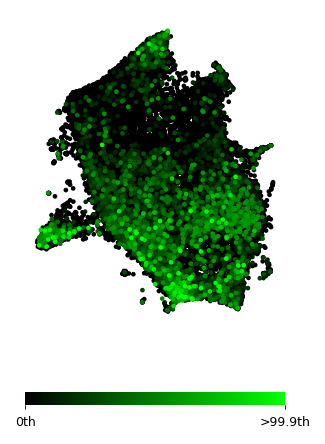

17.767471412658878
18.2996685752877


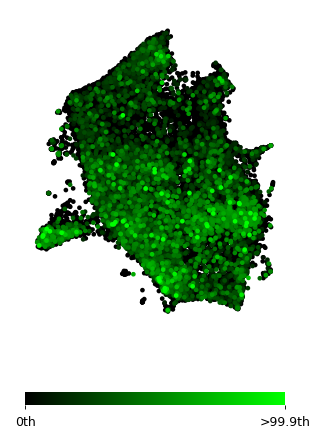

18.2996685752877
194.29303628541896


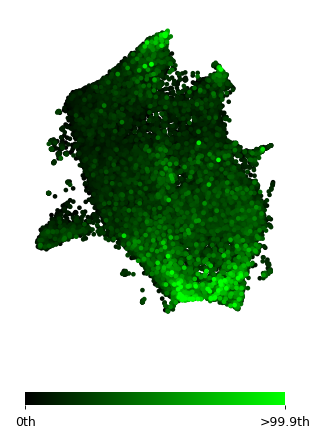

194.29303628541896
43.712834358216114


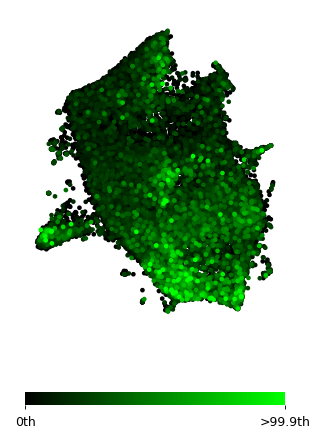

43.712834358216114
52.711928916932024


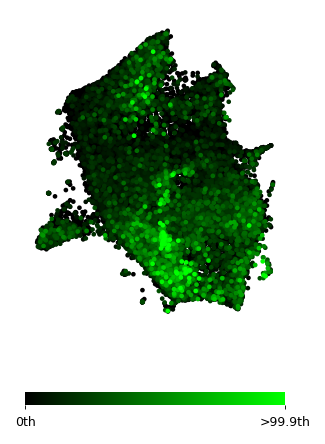

52.711928916932024
19.835767650604854


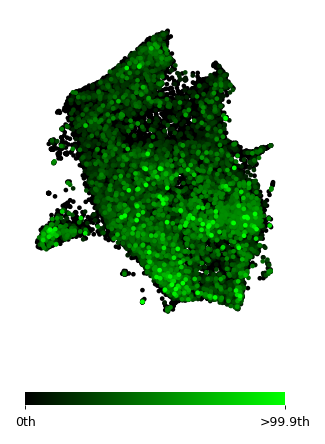

19.835767650604854
118.45135697937546


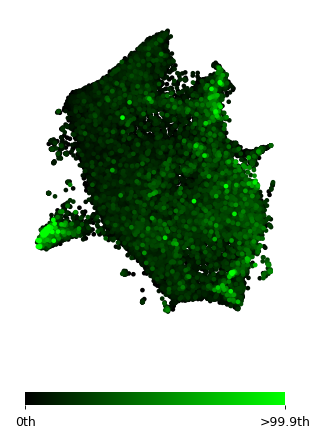

118.45135697937546
176.27942550659205


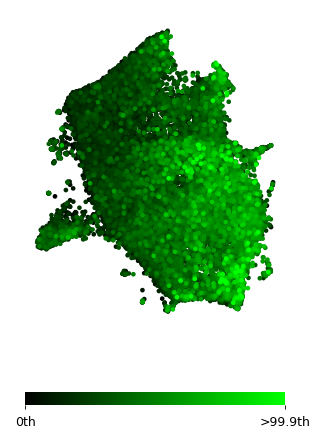

176.27942550659205
470.7489513549947


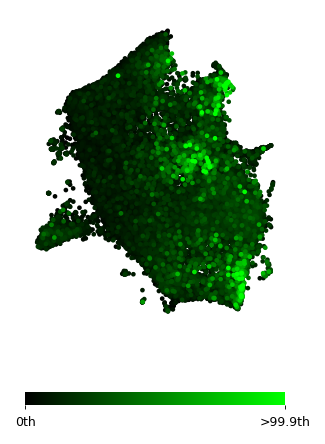

470.7489513549947
90.60394920349142


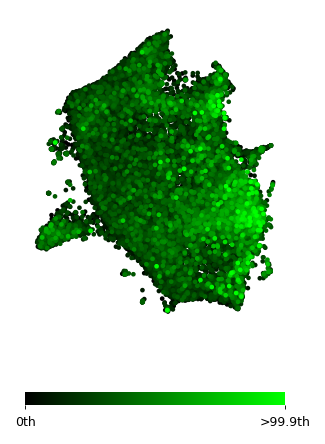

90.60394920349142
210.566749664307


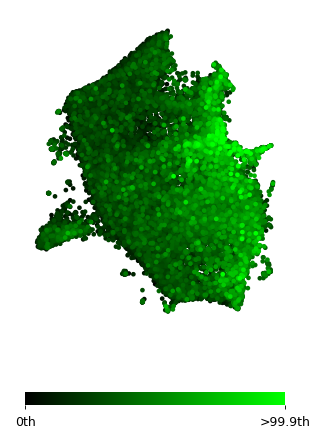

210.566749664307
33.265808631897194


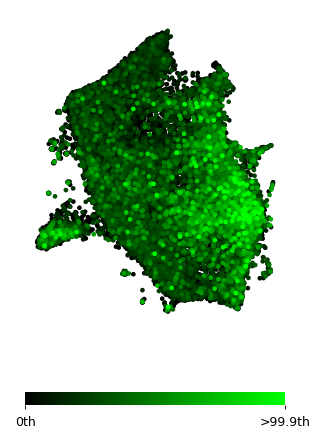

33.265808631897194
40.4040412902832


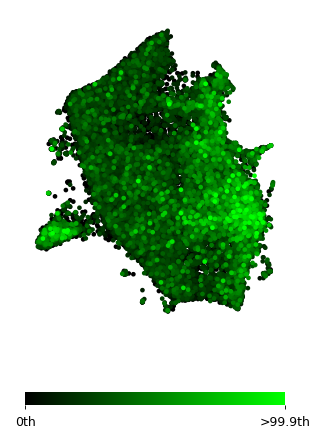

40.4040412902832
21.024886920929333


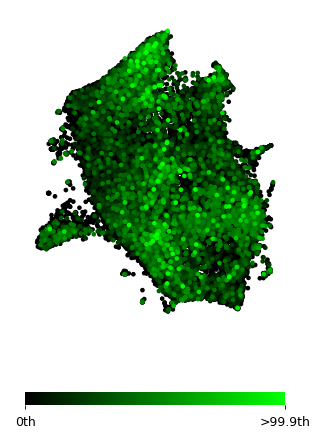

21.024886920929333
1703.5489768066586


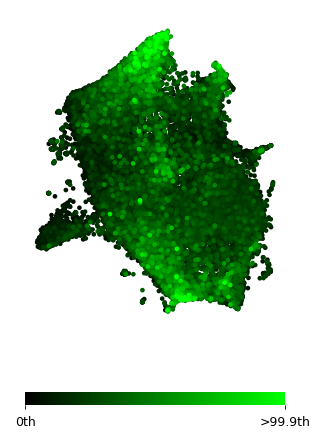

1703.5489768066586
34.07554798889208


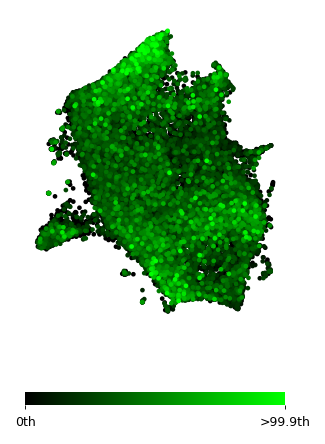

34.07554798889208
43.85891854858414


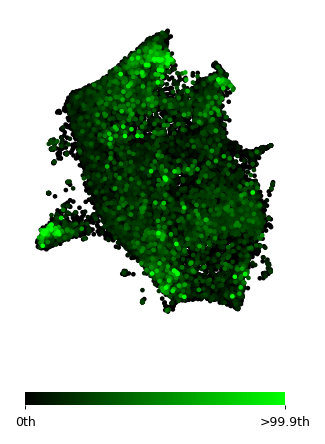

43.85891854858414
21.1047958488467


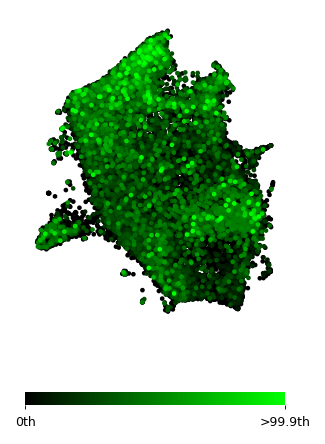

21.1047958488467
29.25863159561205


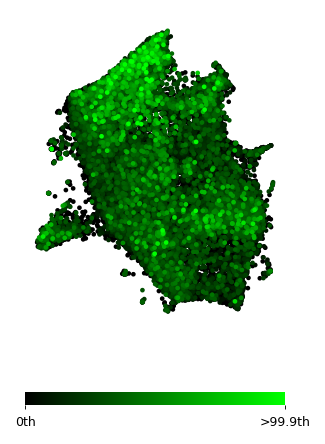

29.25863159561205
42.15731657409694


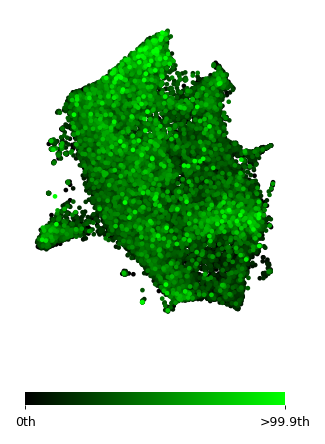

42.15731657409694
41.24191039276168


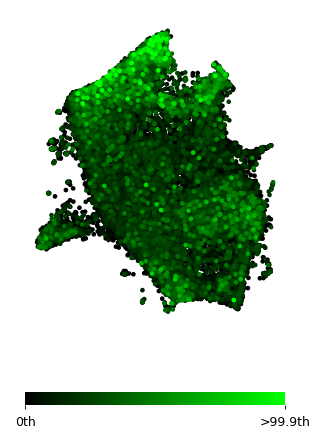

41.24191039276168
20.826914424896756


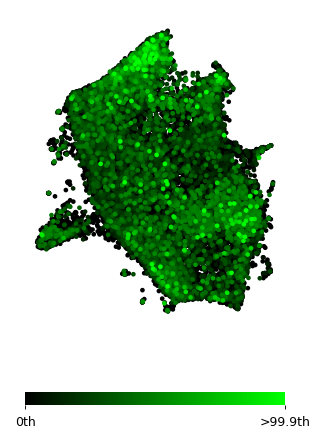

20.826914424896756
53.85746685791122


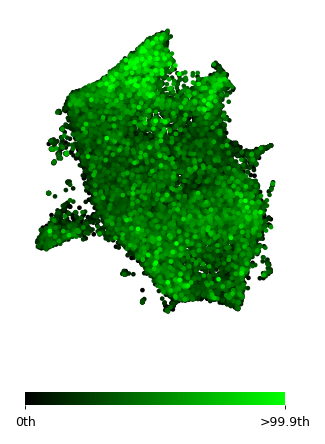

53.85746685791122
29.45325355529922


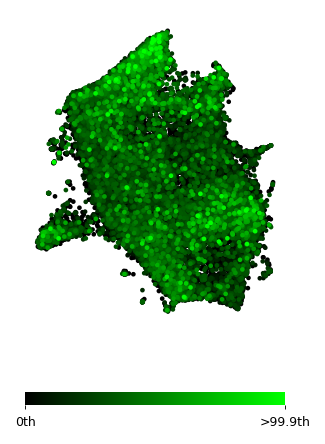

29.45325355529922
26.832082210541127


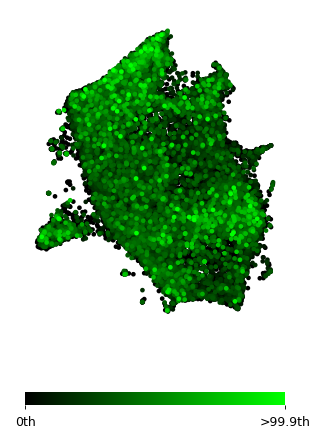

26.832082210541127
28.631437950134583


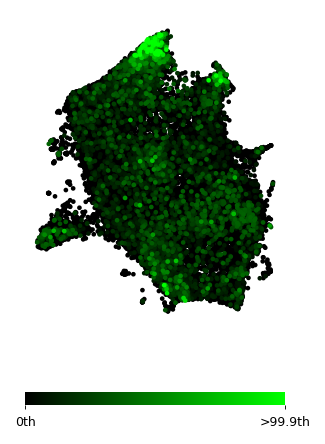

28.631437950134583
17.84082552719151


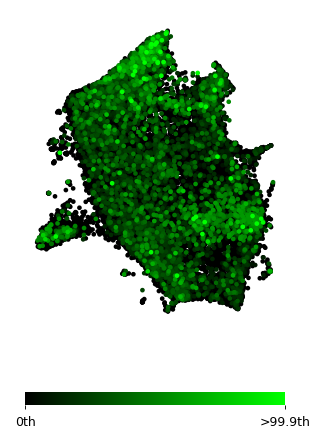

17.84082552719151
81.0067124633826


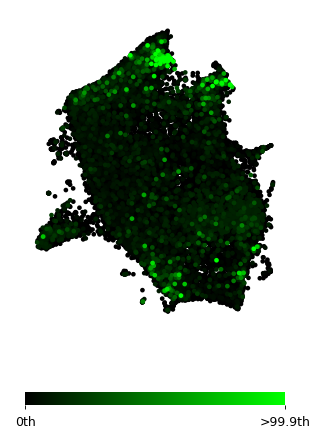

81.0067124633826
24.274078296662957


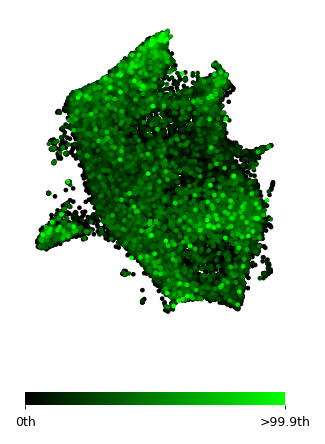

24.274078296662957
30.338977355957212


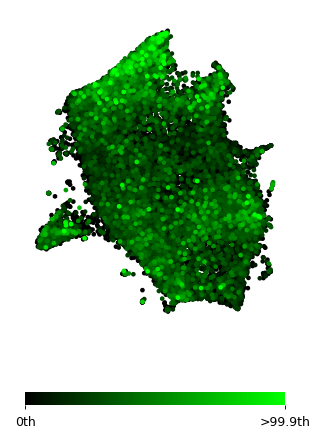

30.338977355957212
20.99927788162238


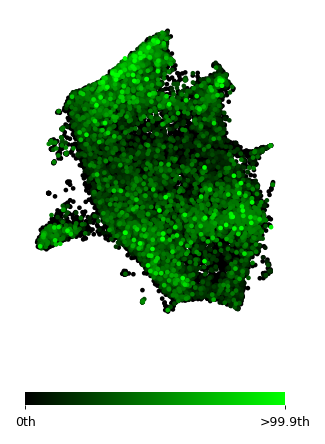

20.99927788162238
87.28348118591438


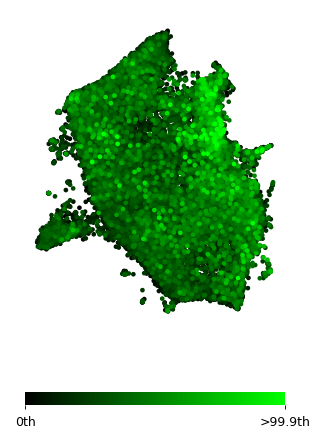

87.28348118591438
68.04131544494811


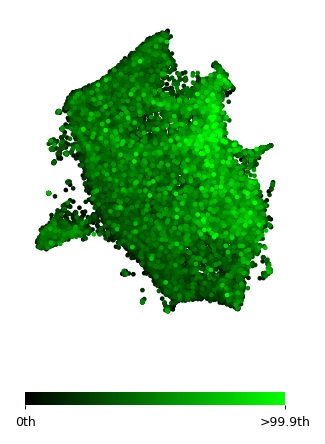

68.04131544494811
44.43661976623571


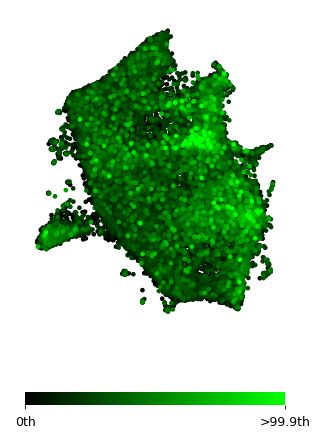

44.43661976623571
32.268145324707255


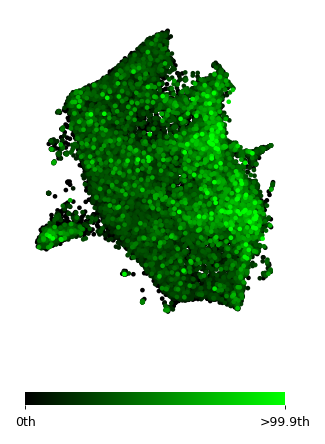

32.268145324707255
112.40043487548951


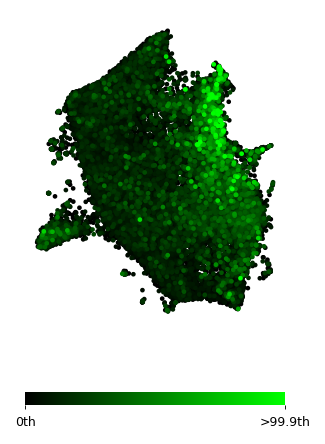

112.40043487548951
20.388562732697064


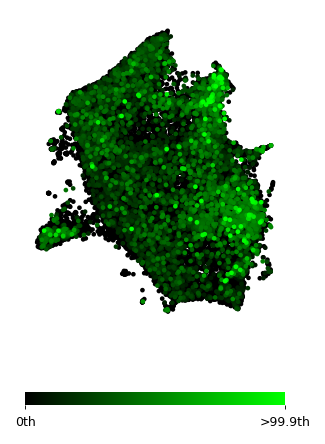

20.388562732697064
27.59280438995384


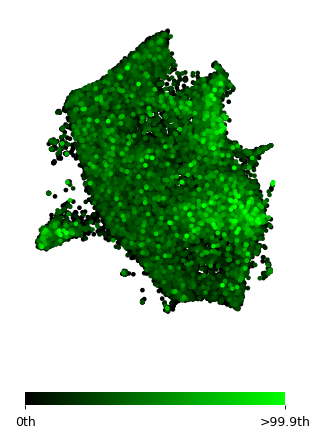

27.59280438995384
104.00686859131052


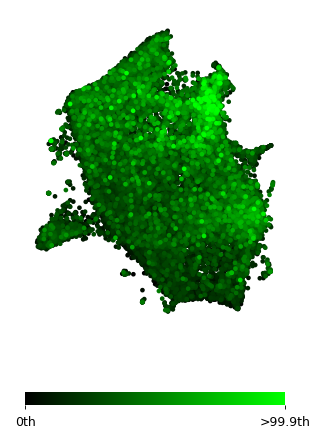

104.00686859131052
57.11285492706321


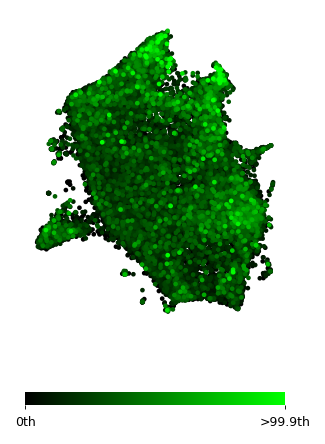

57.11285492706321
100.1244969787615


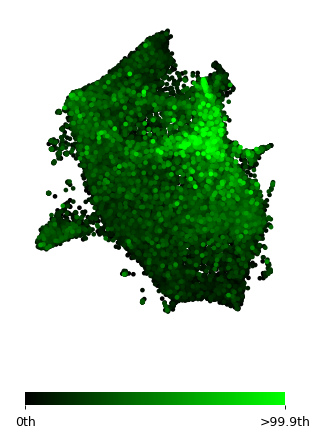

100.1244969787615
80.02713966369839


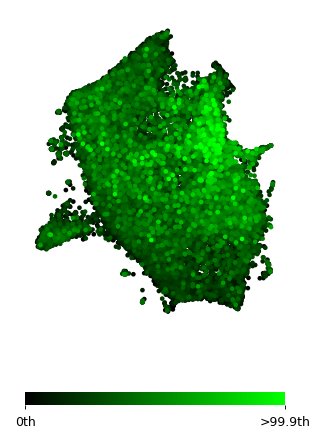

80.02713966369839
52.66483674621669


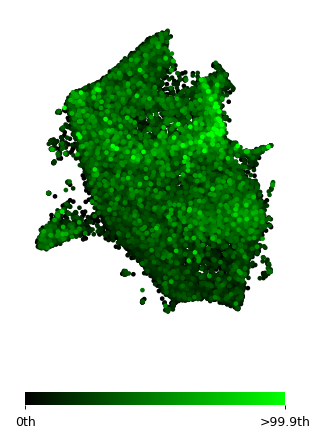

52.66483674621669
43.872425155640016


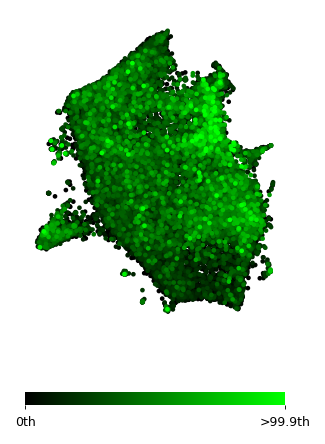

43.872425155640016
37.63290602874804


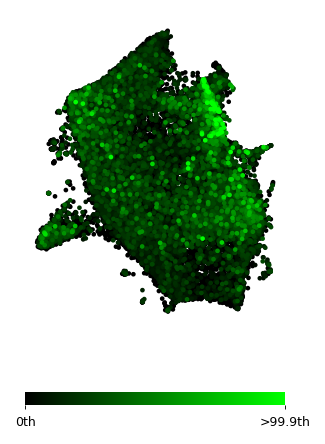

37.63290602874804
22.212011299133373


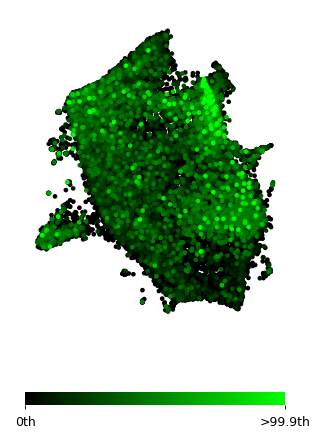

22.212011299133373
18.320850303650104


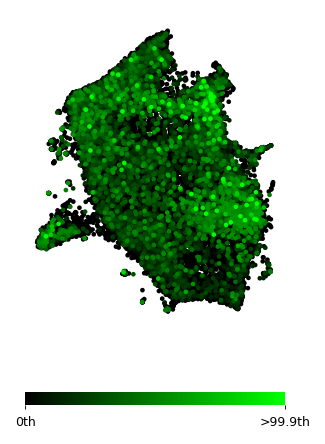

18.320850303650104
32.43645784759594


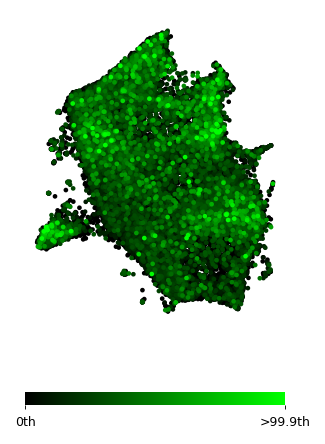

32.43645784759594
1003.1414456787206


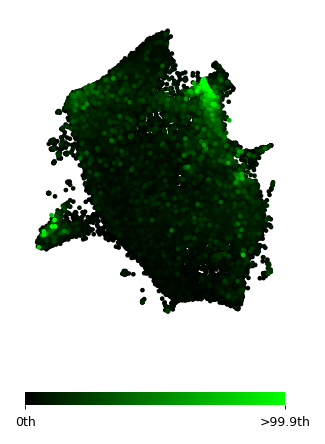

1003.1414456787206
23.801581291200016


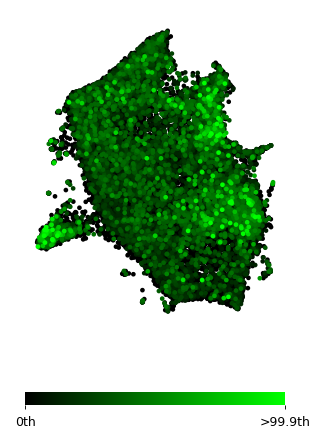

23.801581291200016
46.45367593383796


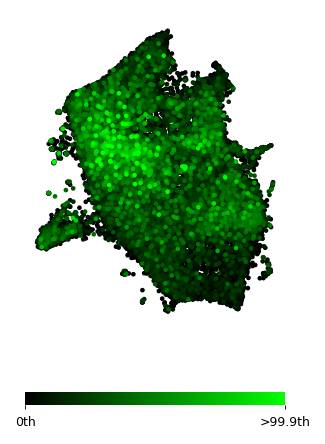

46.45367593383796
23.47417864227295


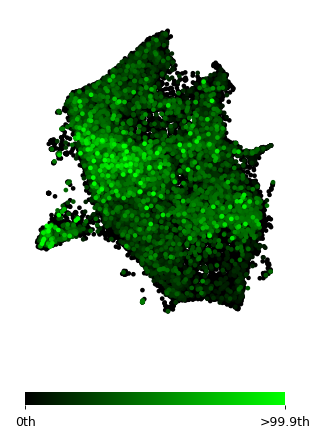

23.47417864227295
61.39056548309523


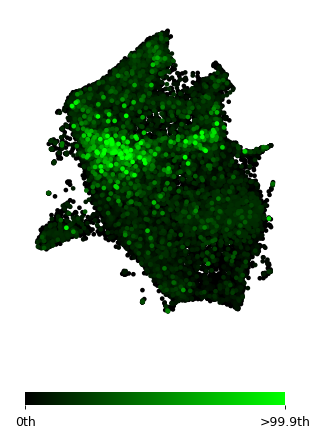

61.39056548309523
27.676399040223266


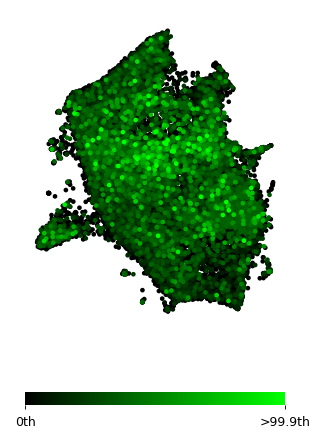

27.676399040223266
25.057458976745643


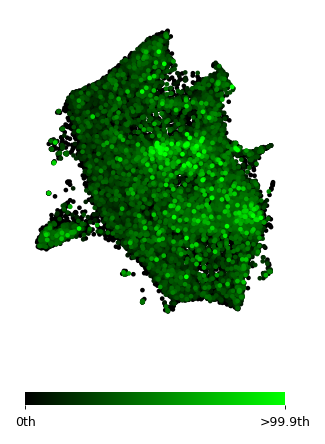

25.057458976745643
88.86296279907961


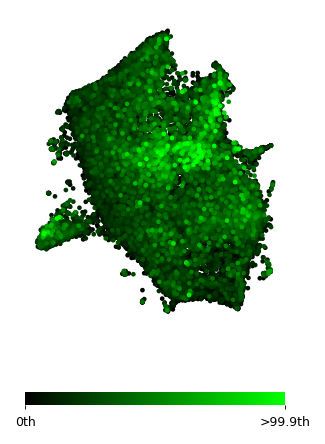

88.86296279907961
106.44070001220732


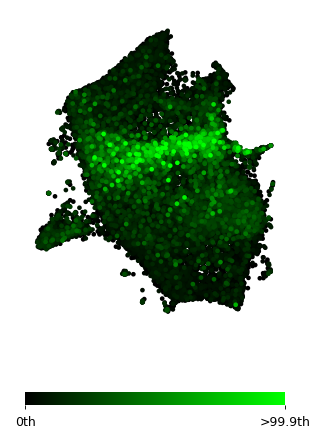

106.44070001220732
55.873810691834436


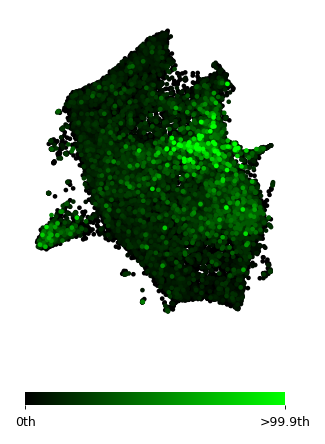

55.873810691834436
45.8037637557984


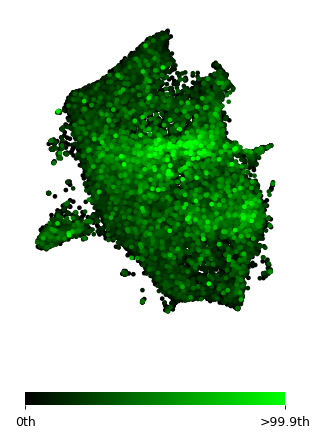

45.8037637557984
72.6170339355479


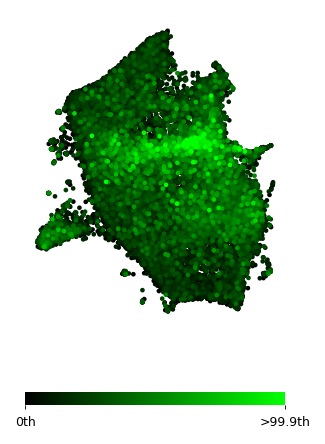

72.6170339355479
34.30924866485628


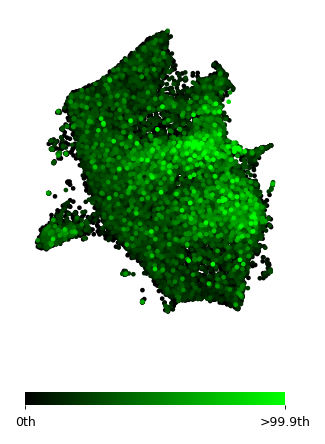

34.30924866485628
116.37796907043776


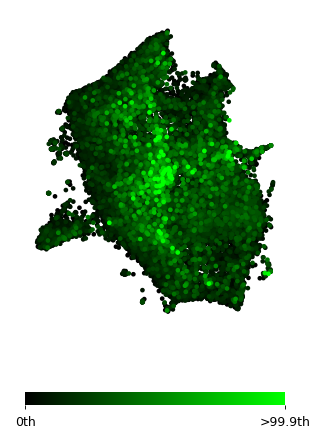

116.37796907043776
29.15153580474869


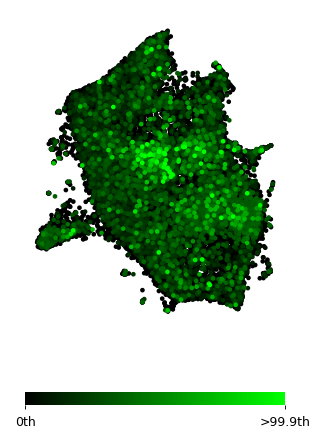

29.15153580474869
19.27375823593152


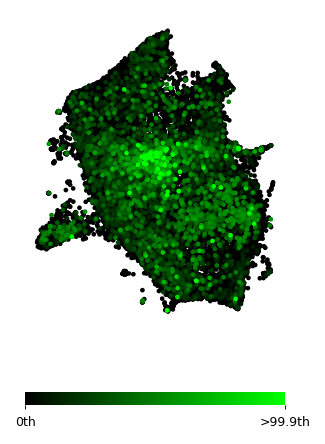

19.27375823593152
51.856898941040086


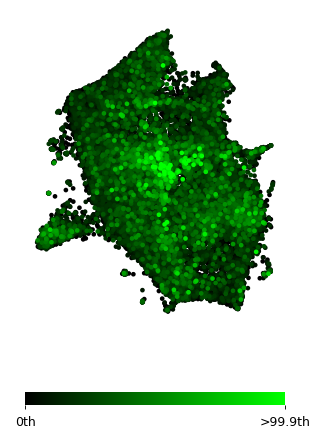

51.856898941040086
47.62107589721752


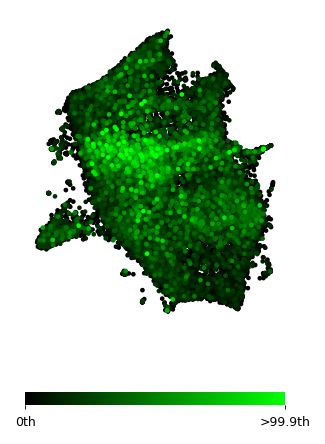

47.62107589721752
21.493636558533353


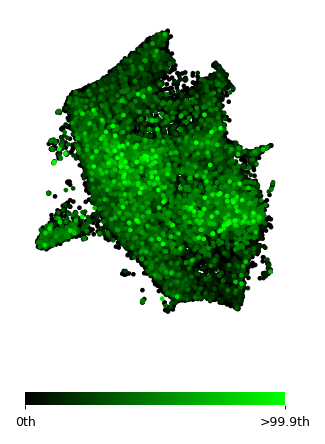

21.493636558533353
23.156972698211895


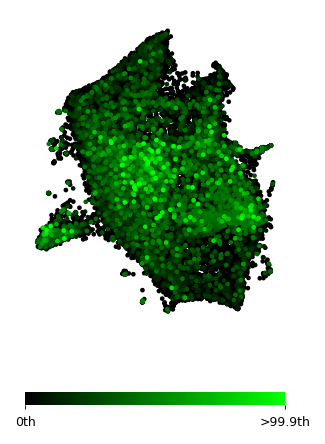

23.156972698211895
13.390502710342606


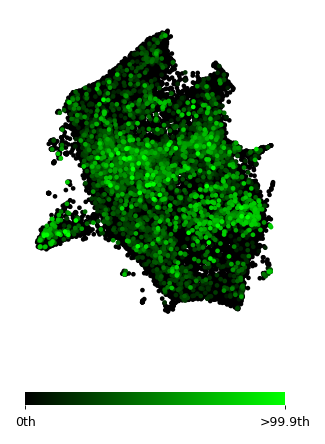

13.390502710342606
48.852802597046065


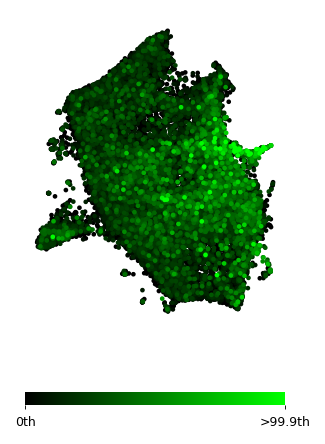

48.852802597046065
11.408834001541528


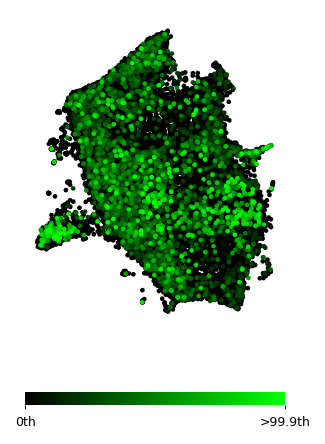

11.408834001541528
14.426883359909304


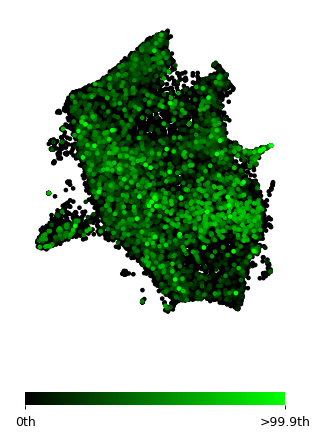

14.426883359909304
11.039636898040843


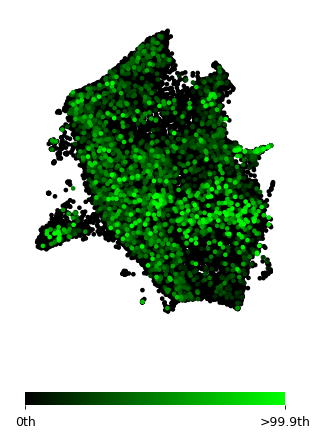

11.039636898040843
16.246093788147167


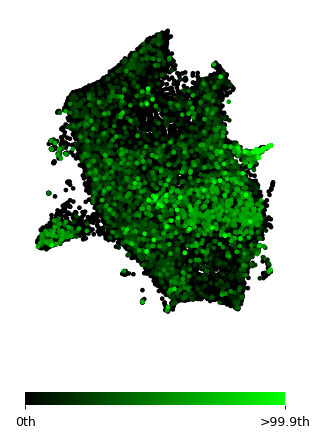

16.246093788147167
10.724853109359774


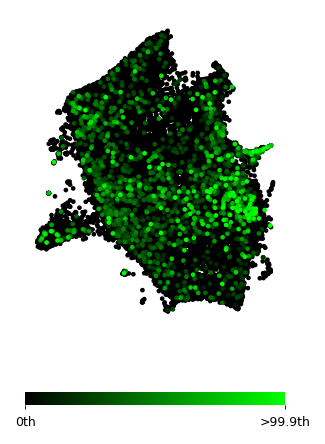

10.724853109359774
11.821730361938837


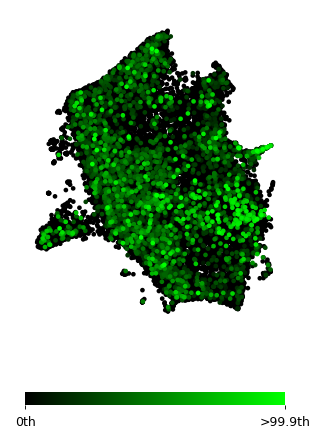

11.821730361938837
32.39096778106809


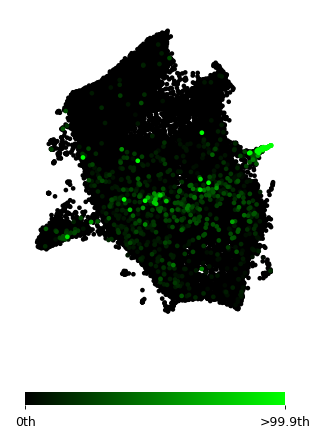

32.39096778106809
7.9524314146043


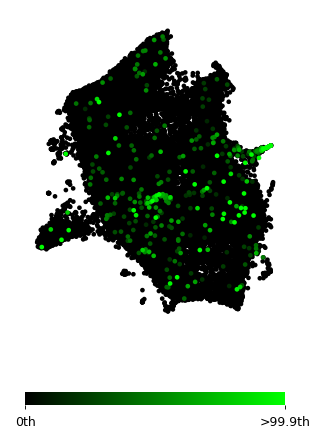

7.9524314146043
5.879696662902976


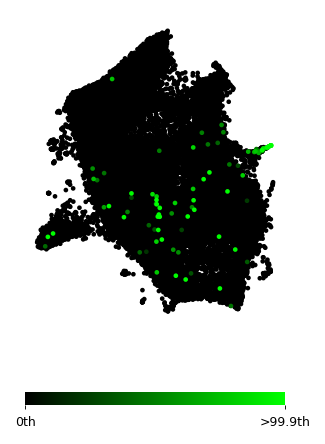

5.879696662902976
7.573072331429172


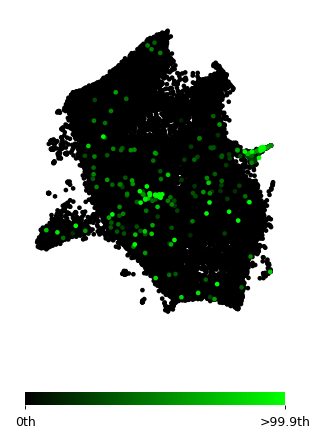

7.573072331429172
6.173555681228852


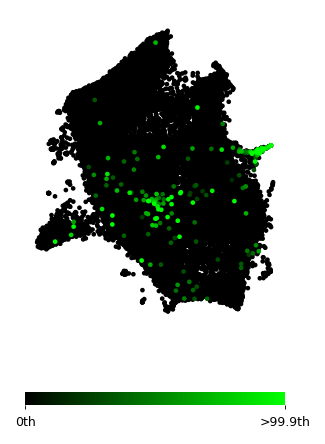

6.173555681228852
10.747906564712558


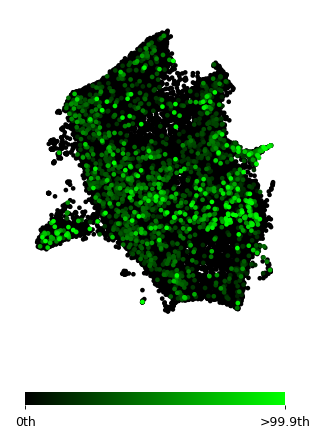

10.747906564712558
10.883442451477121


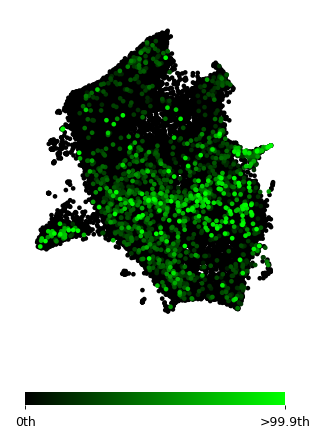

10.883442451477121
10.17045908546457


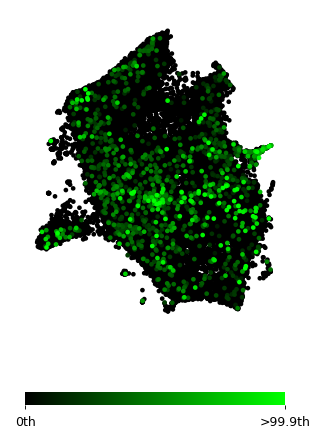

10.17045908546457
10.534746849060156


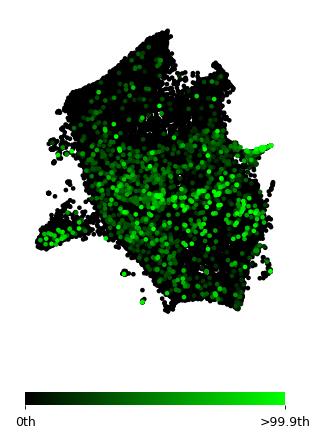

10.534746849060156
10.613010982513527


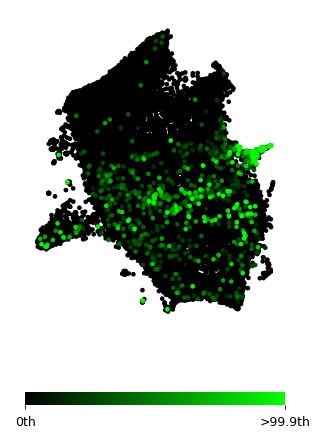

10.613010982513527
10.431105037689392


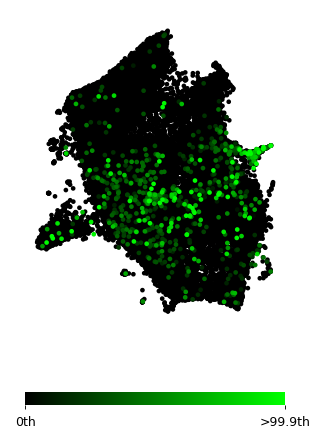

10.431105037689392
29.43041770553591


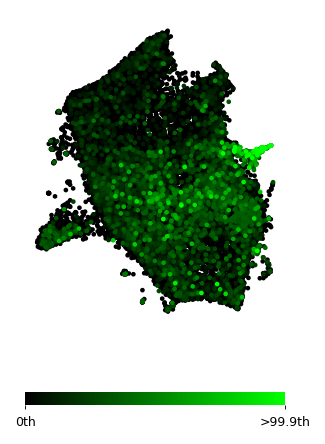

29.43041770553591
11.049724578857422


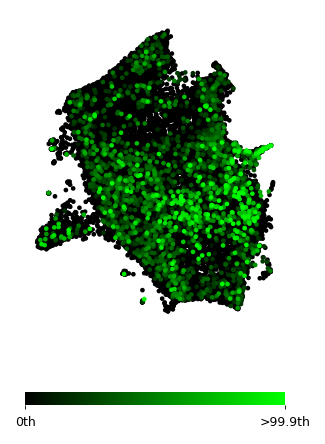

11.049724578857422
32.36942691803145


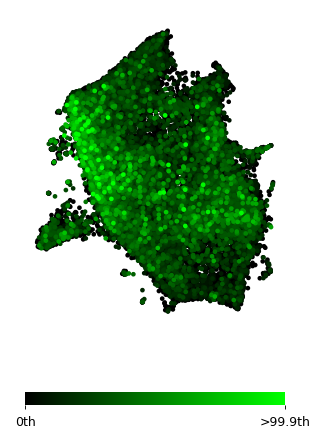

32.36942691803145
21.635332988739084


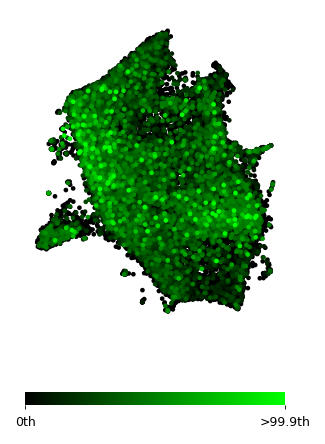

21.635332988739084
285.99775500488744


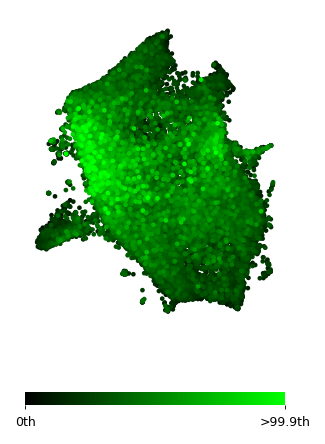

285.99775500488744
73.62194677734531


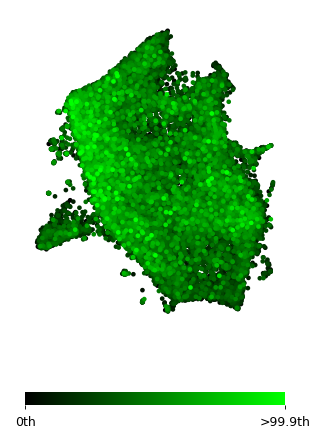

73.62194677734531
106.88660023498548


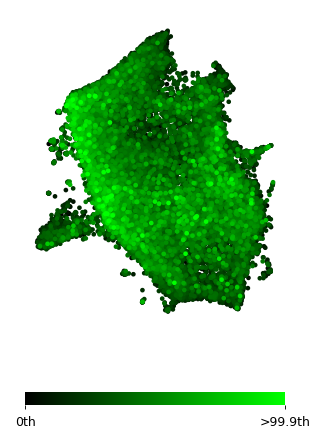

106.88660023498548
70.39082122802773


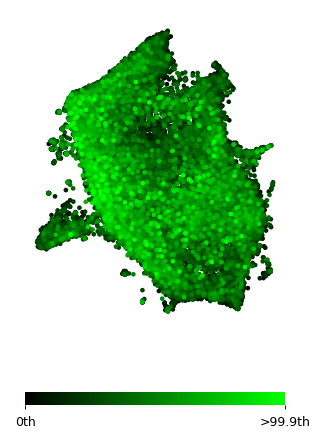

70.39082122802773
124.57816915893633


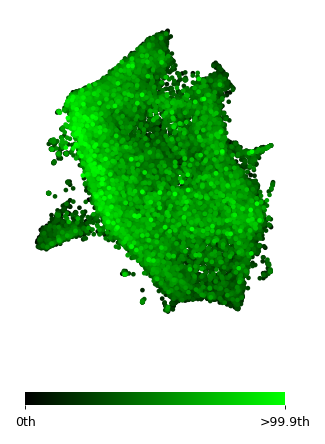

124.57816915893633
131.58547741699311


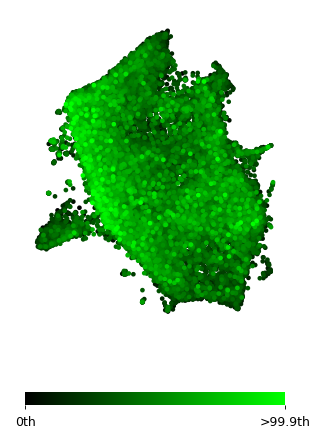

131.58547741699311
67.24235652160682


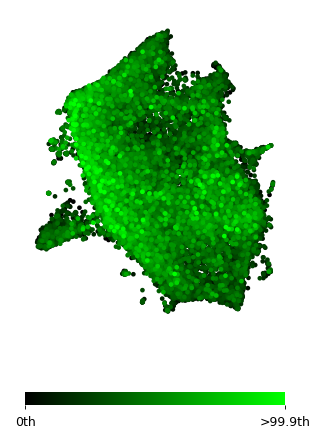

67.24235652160682
75.59865391540617


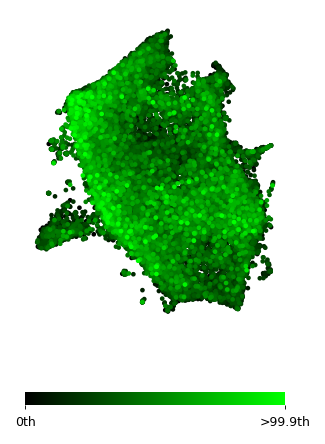

75.59865391540617
278.8449783325208


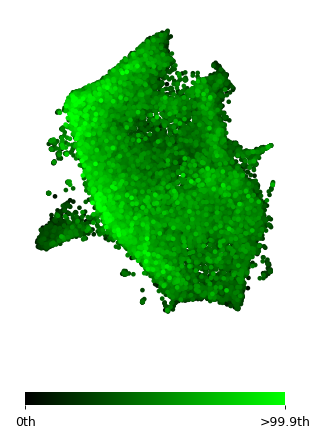

278.8449783325208
253.2957016601569


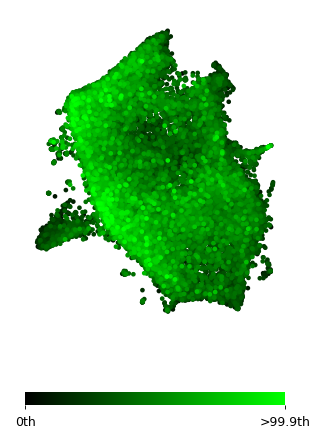

253.2957016601569
425.9922542114632


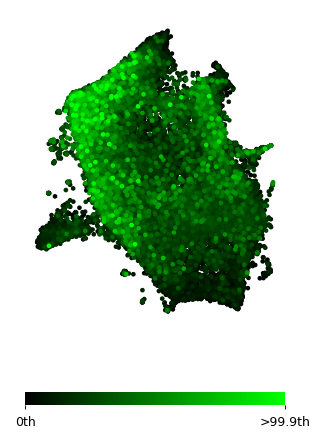

425.9922542114632
137.5362879943863


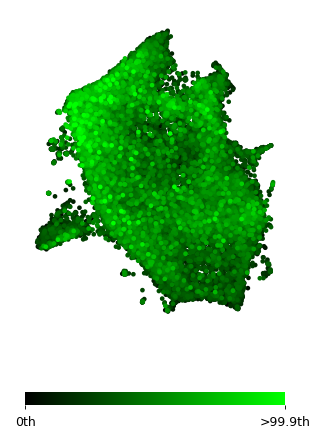

137.5362879943863
17.972302173615887


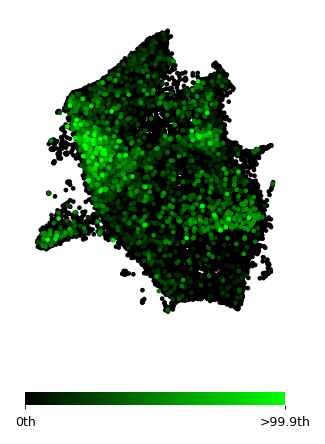

17.972302173615887
41.635378631592786


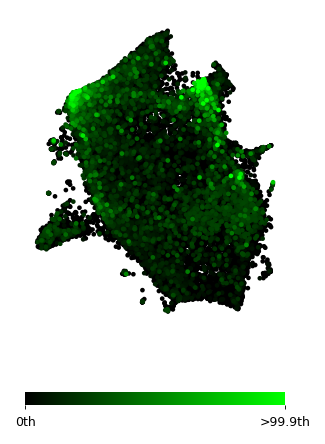

41.635378631592786
21.307154529571804


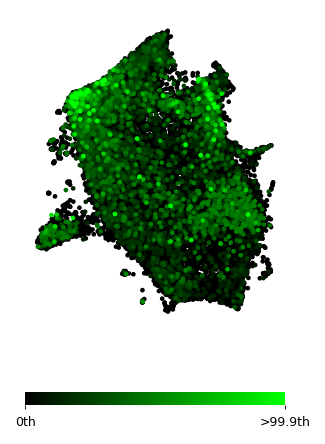

21.307154529571804


In [30]:
genes = inheat

ftypes = ['png','pdf']

!mkdir -p postannotoutputs/umapbygene/all_data_combined

for gene in genes:
    
    gmask = adata.var_names == gene
    expression = adata.X[cmask][:,gmask].toarray().T[0]
    
    show=True
    for ftype in ftypes:
        spring_like(
                gene,
                expression,
                x,y,
                box = [0,0,1,1],
                s = 5,
                pctilemax = 99.9,
                vmax=None,
                w = 5,
                h = 7.5,
                comment = '',
                pad = 0,
                ftype = ftype,
                dpi = 1200.,
                show_cbar=True,
                lims = [],
                save=True,
                show=show,
                outputdir='postannotoutputs/umapbygene/all_data_combined/'
                )
        show=False

## Color plot and split by condition

116.4563478851343
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


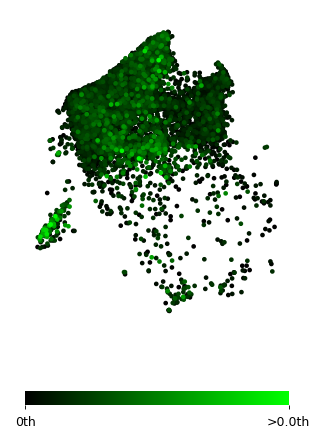

116.4563478851343
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
116.4563478851343
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
116.4563478851343
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
116.4563478851343
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
116.4563478851343
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
95.87251991271975
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


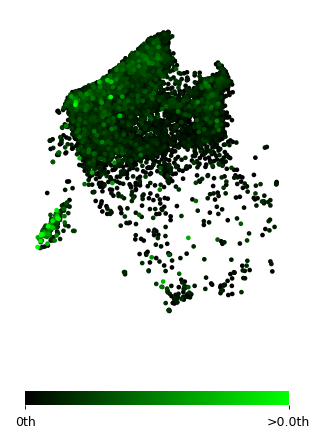

95.87251991271975
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
95.87251991271975
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
95.87251991271975
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
95.87251991271975
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
95.87251991271975
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
3404.0035761718827
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


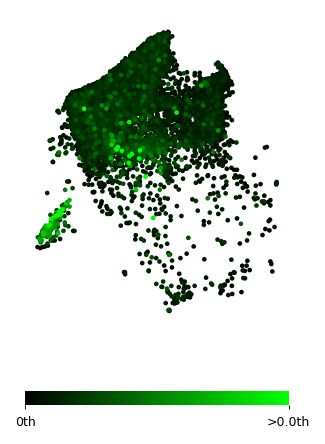

3404.0035761718827
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
3404.0035761718827
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
3404.0035761718827
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
3404.0035761718827
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
3404.0035761718827
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
413.7924569091803
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


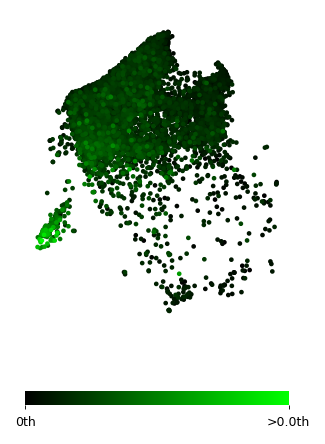

413.7924569091803
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
413.7924569091803
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
413.7924569091803
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
413.7924569091803
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
413.7924569091803
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
85.87089010620181
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


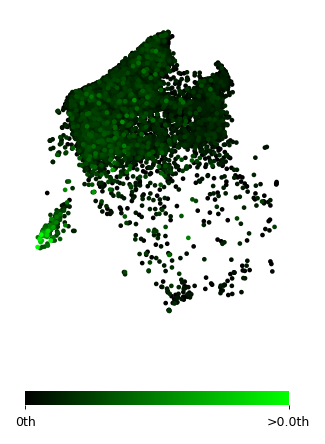

85.87089010620181
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
85.87089010620181
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
85.87089010620181
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
85.87089010620181
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
85.87089010620181
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
222.96735610962065
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


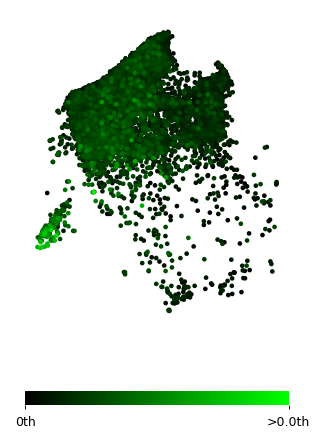

222.96735610962065
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
222.96735610962065
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
222.96735610962065
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
222.96735610962065
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
222.96735610962065
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
363.90238458253407
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


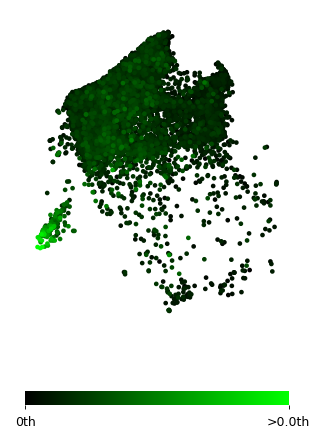

363.90238458253407
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
363.90238458253407
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
363.90238458253407
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
363.90238458253407
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
363.90238458253407
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
478.83231231691434
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


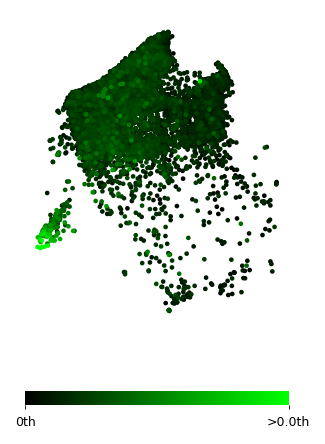

478.83231231691434
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
478.83231231691434
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
478.83231231691434
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
478.83231231691434
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
478.83231231691434
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
430.47700170899645
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


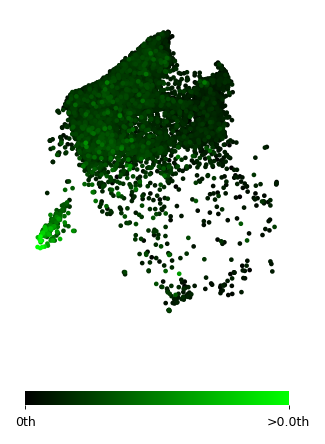

430.47700170899645
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
430.47700170899645
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
430.47700170899645
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
430.47700170899645
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
430.47700170899645
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
541.5723571777371
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


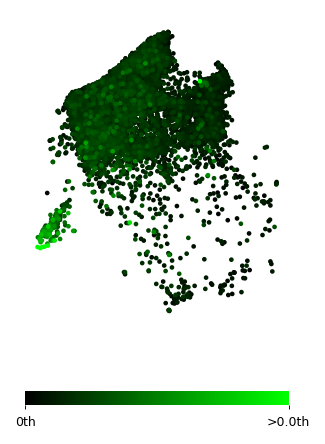

541.5723571777371
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
541.5723571777371
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
541.5723571777371
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
541.5723571777371
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
541.5723571777371
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.38294779205334
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


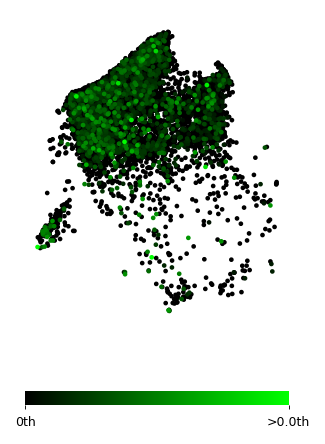

18.38294779205334
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
18.38294779205334
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.38294779205334
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.38294779205334
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.38294779205334
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
455.908005615237
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


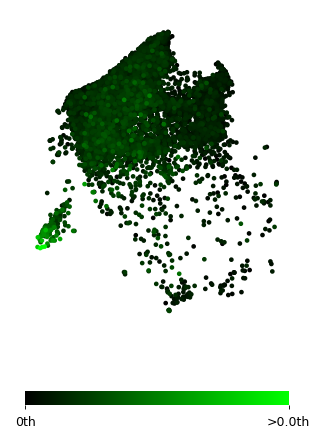

455.908005615237
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
455.908005615237
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
455.908005615237
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
455.908005615237
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
455.908005615237
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.928122135162614
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


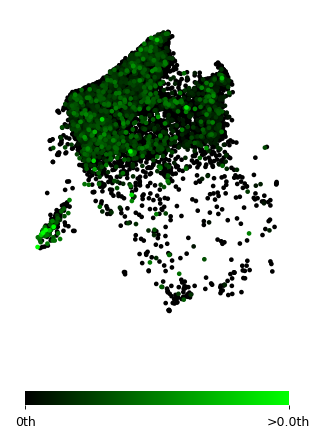

20.928122135162614
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.928122135162614
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.928122135162614
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.928122135162614
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.928122135162614
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
46.98068516540543
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


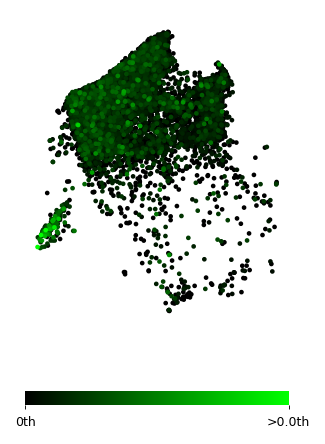

46.98068516540543
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
46.98068516540543
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
46.98068516540543
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
46.98068516540543
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
46.98068516540543
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
40.52437359619243
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


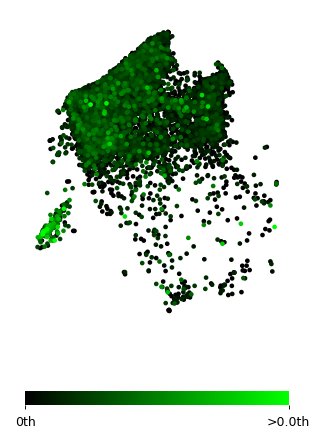

40.52437359619243
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
40.52437359619243
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
40.52437359619243
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
40.52437359619243
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
40.52437359619243
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.56737705612189
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


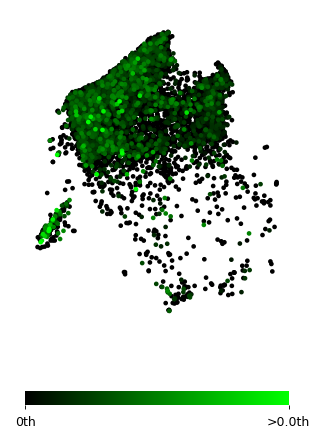

20.56737705612189
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.56737705612189
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.56737705612189
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.56737705612189
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.56737705612189
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
113.17908267212024
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


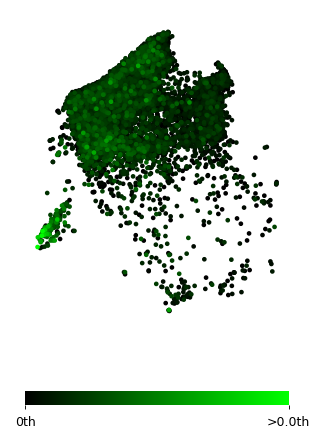

113.17908267212024
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
113.17908267212024
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
113.17908267212024
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
113.17908267212024
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
113.17908267212024
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
206.15420223999303
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


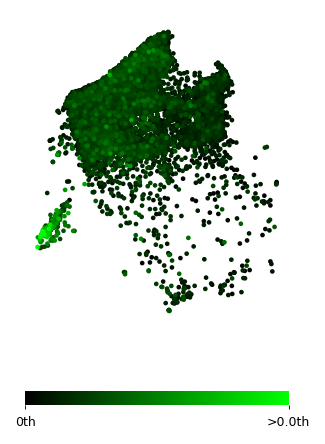

206.15420223999303
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
206.15420223999303
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
206.15420223999303
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
206.15420223999303
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
206.15420223999303
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
517.3543037109424
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


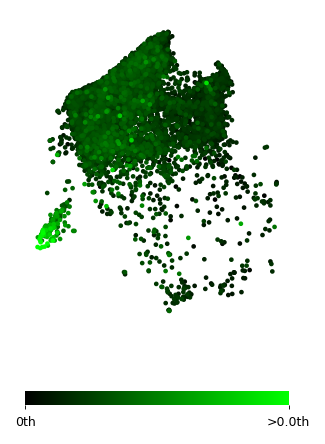

517.3543037109424
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
517.3543037109424
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
517.3543037109424
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
517.3543037109424
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
517.3543037109424
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
28.093294925689815
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


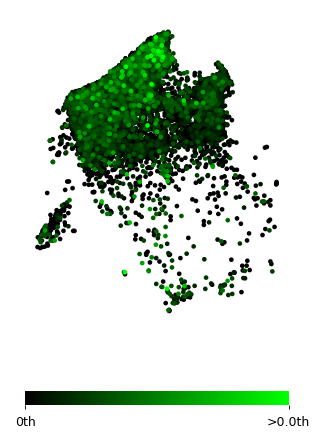

28.093294925689815
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
28.093294925689815
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
28.093294925689815
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
28.093294925689815
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
28.093294925689815
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1707.007667724632
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


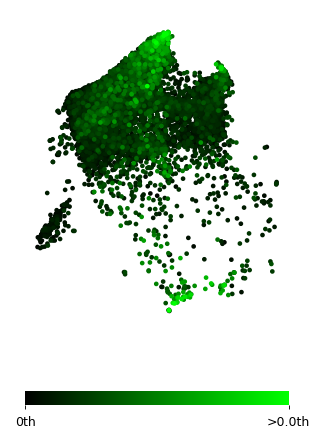

1707.007667724632
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
1707.007667724632
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1707.007667724632
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1707.007667724632
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1707.007667724632
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.8096539306641
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


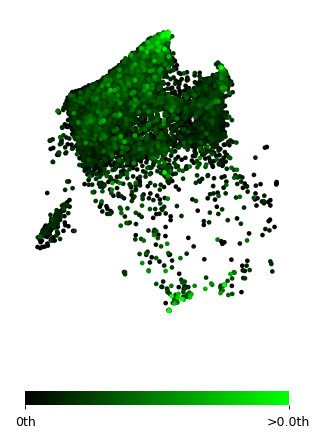

55.8096539306641
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
55.8096539306641
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.8096539306641
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.8096539306641
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.8096539306641
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
36.48836017608672
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


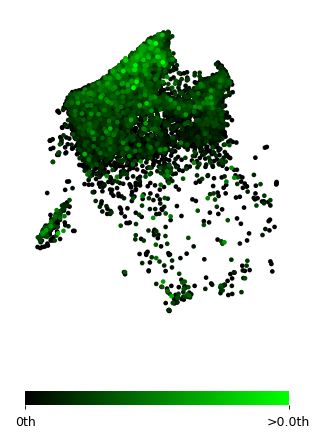

36.48836017608672
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
36.48836017608672
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
36.48836017608672
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
36.48836017608672
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
36.48836017608672
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
22.06833543014531
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


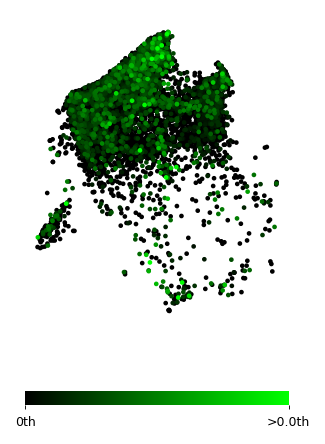

22.06833543014531
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
22.06833543014531
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
22.06833543014531
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
22.06833543014531
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
22.06833543014531
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.31373254776043
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


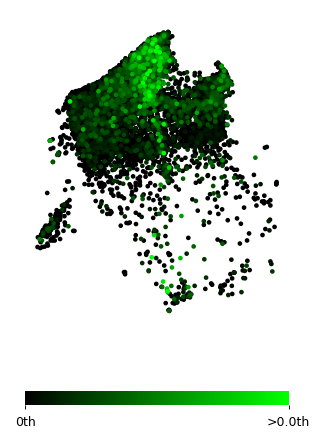

31.31373254776043
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
31.31373254776043
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.31373254776043
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.31373254776043
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.31373254776043
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
53.29415066528348
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


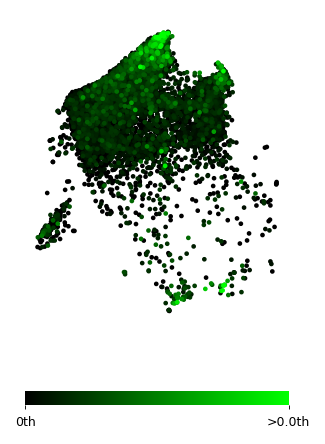

53.29415066528348
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
53.29415066528348
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
53.29415066528348
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
53.29415066528348
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
53.29415066528348
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
39.22514888000555
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


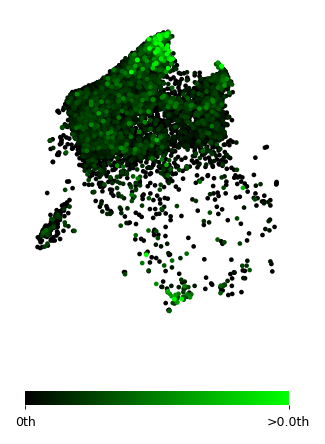

39.22514888000555
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
39.22514888000555
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
39.22514888000555
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
39.22514888000555
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
39.22514888000555
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.617987430572708
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


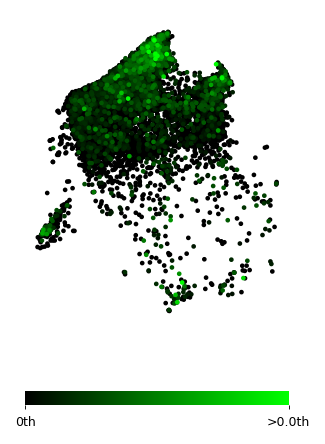

31.617987430572708
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
31.617987430572708
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.617987430572708
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.617987430572708
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.617987430572708
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.36653993988112
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


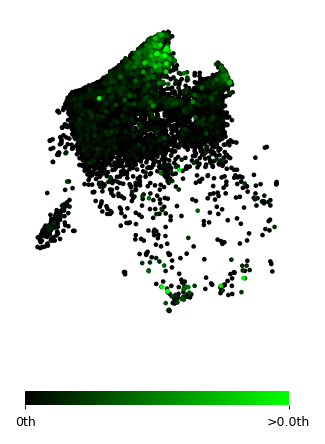

57.36653993988112
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
57.36653993988112
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.36653993988112
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.36653993988112
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.36653993988112
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.75462564849859
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


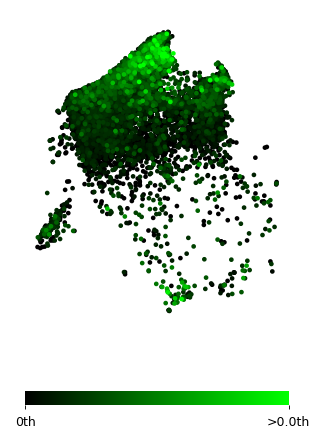

57.75462564849859
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
57.75462564849859
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.75462564849859
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.75462564849859
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.75462564849859
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.52338078308239
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


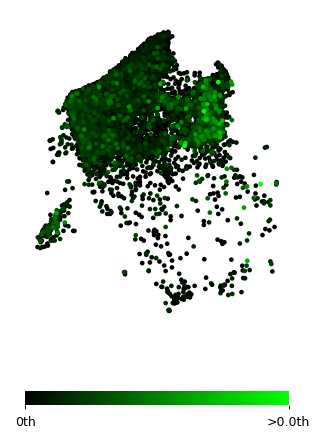

55.52338078308239
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
55.52338078308239
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.52338078308239
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.52338078308239
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.52338078308239
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.89588182449348
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


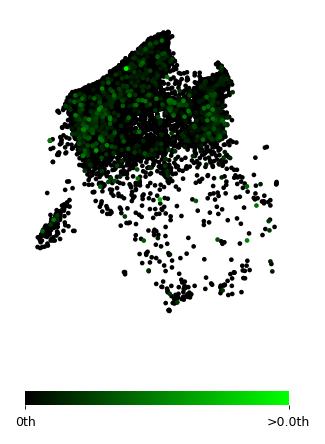

21.89588182449348
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.89588182449348
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.89588182449348
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.89588182449348
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.89588182449348
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.635212688446117
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


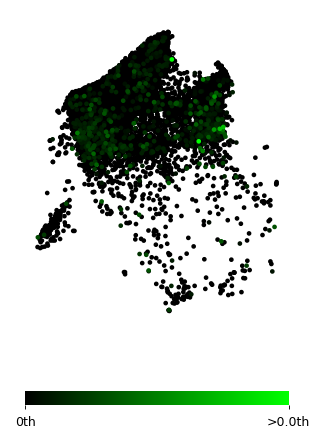

31.635212688446117
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
31.635212688446117
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.635212688446117
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
31.635212688446117
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
31.635212688446117
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.021349052429265
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


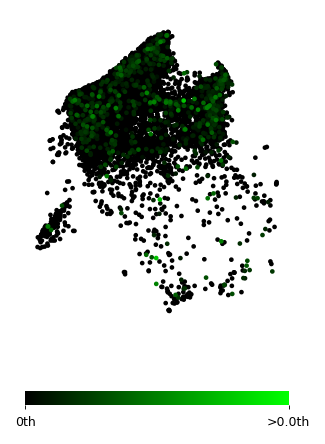

21.021349052429265
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.021349052429265
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.021349052429265
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.021349052429265
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.021349052429265
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
83.69727397155822
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


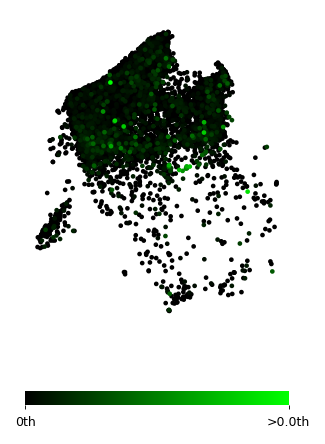

83.69727397155822
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
83.69727397155822
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
83.69727397155822
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
83.69727397155822
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
83.69727397155822
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
36.21528624725427
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


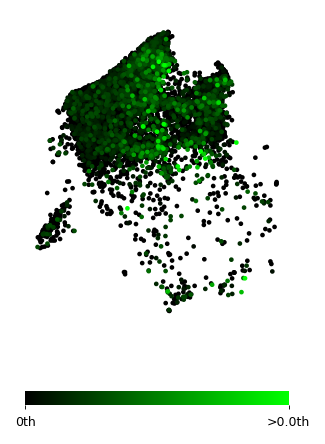

36.21528624725427
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
36.21528624725427
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
36.21528624725427
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
36.21528624725427
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
36.21528624725427
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
701.1031147460944
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


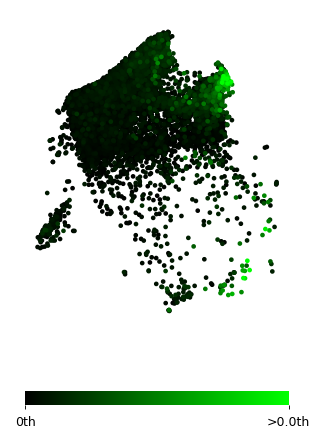

701.1031147460944
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
701.1031147460944
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
701.1031147460944
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
701.1031147460944
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
701.1031147460944
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
131.09834567260776
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


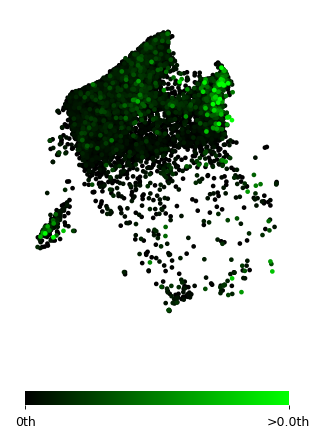

131.09834567260776
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
131.09834567260776
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
131.09834567260776
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
131.09834567260776
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
131.09834567260776
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
59.28386113739286
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


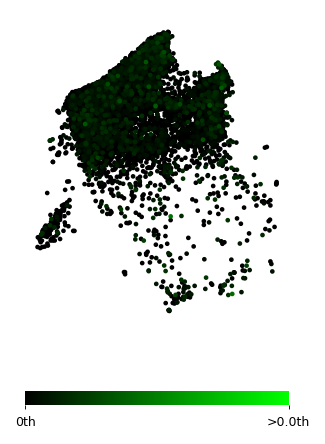

59.28386113739286
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
59.28386113739286
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
59.28386113739286
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
59.28386113739286
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
59.28386113739286
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.374688774109835
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


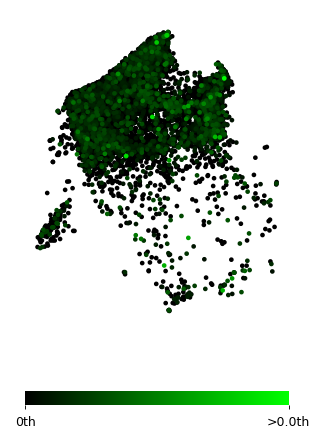

34.374688774109835
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
34.374688774109835
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.374688774109835
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.374688774109835
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.374688774109835
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
127.05099307251538
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


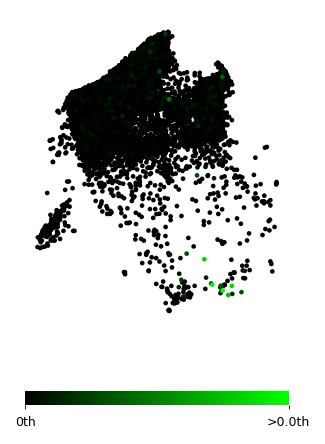

127.05099307251538
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
127.05099307251538
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
127.05099307251538
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
127.05099307251538
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
127.05099307251538
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
79.6547416839635
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


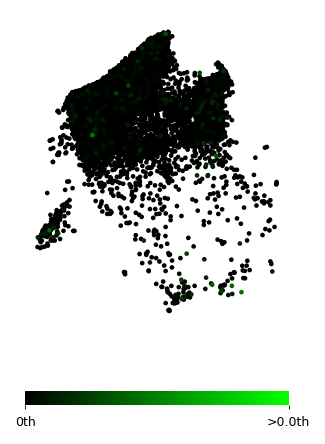

79.6547416839635
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
79.6547416839635
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
79.6547416839635
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
79.6547416839635
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
79.6547416839635
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
254.10845260620312
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


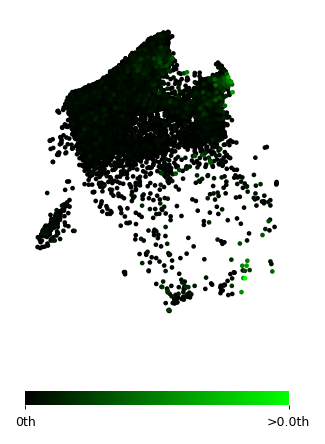

254.10845260620312
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
254.10845260620312
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
254.10845260620312
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
254.10845260620312
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
254.10845260620312
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
831.3523404541193
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


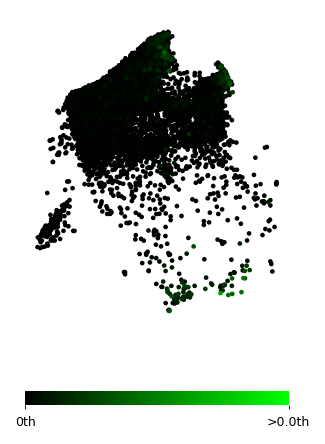

831.3523404541193
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
831.3523404541193
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
831.3523404541193
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
831.3523404541193
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
831.3523404541193
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
835.5929664306722
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


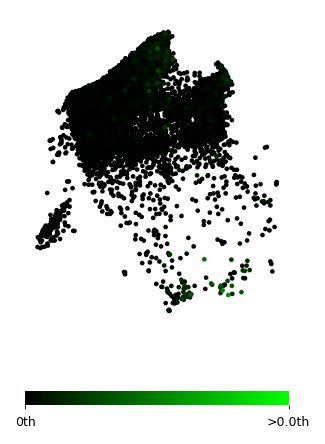

835.5929664306722
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
835.5929664306722
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
835.5929664306722
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
835.5929664306722
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
835.5929664306722
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
583.146654418968
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


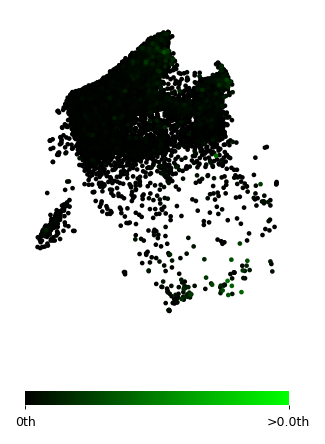

583.146654418968
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
583.146654418968
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
583.146654418968
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
583.146654418968
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
583.146654418968
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.96092761612197
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


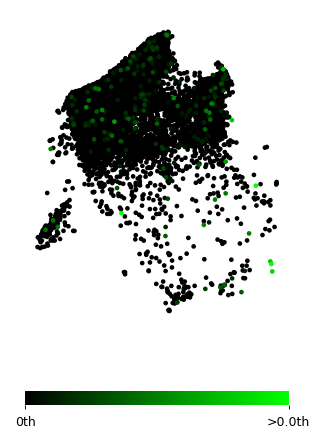

20.96092761612197
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.96092761612197
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.96092761612197
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.96092761612197
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.96092761612197
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.687202556611204
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


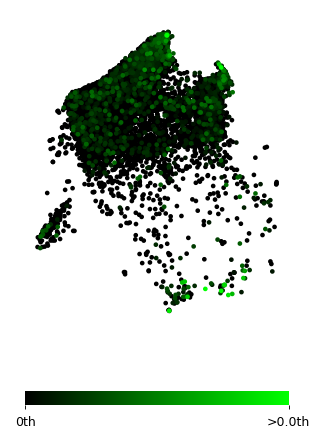

25.687202556611204
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
25.687202556611204
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.687202556611204
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.687202556611204
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.687202556611204
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.055758045196924
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


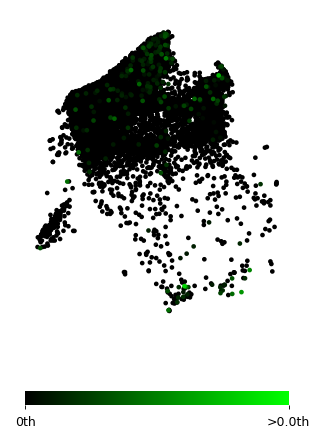

25.055758045196924
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
25.055758045196924
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.055758045196924
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.055758045196924
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.055758045196924
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
37.6647834777832
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


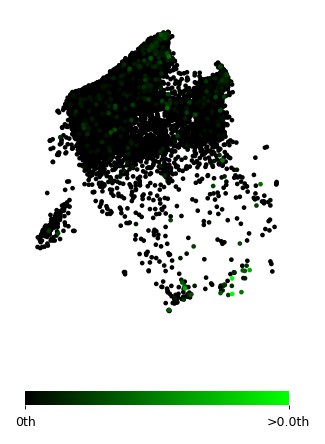

37.6647834777832
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
37.6647834777832
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
37.6647834777832
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
37.6647834777832
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
37.6647834777832
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
79.9995592956608
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


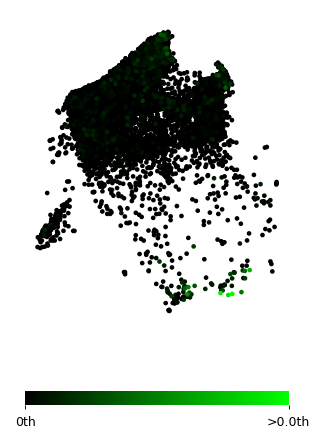

79.9995592956608
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
79.9995592956608
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
79.9995592956608
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
79.9995592956608
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
79.9995592956608
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.878303760528794
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


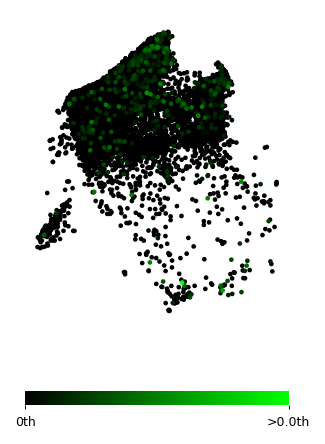

18.878303760528794
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
18.878303760528794
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.878303760528794
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.878303760528794
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.878303760528794
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.767471412658878
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


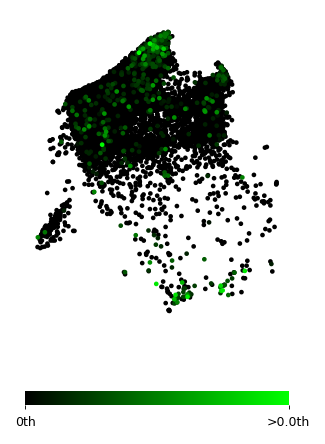

17.767471412658878
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
17.767471412658878
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.767471412658878
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.767471412658878
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.767471412658878
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.2996685752877
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


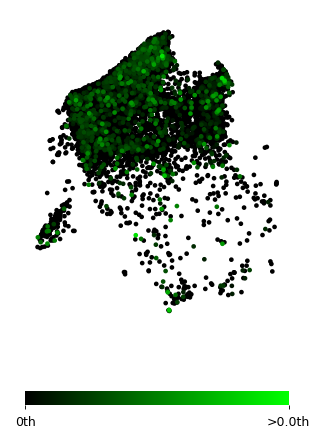

18.2996685752877
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
18.2996685752877
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.2996685752877
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.2996685752877
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.2996685752877
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
194.29303628541896
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


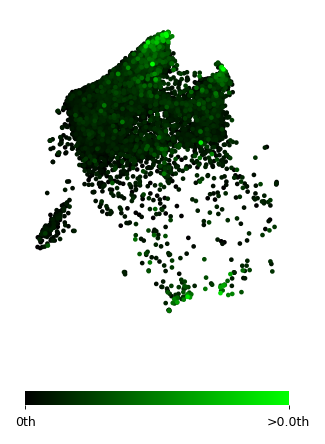

194.29303628541896
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
194.29303628541896
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
194.29303628541896
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
194.29303628541896
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
194.29303628541896
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.712834358216114
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


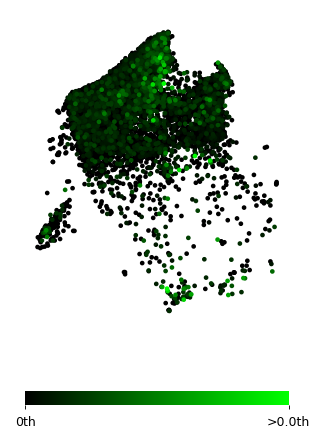

43.712834358216114
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
43.712834358216114
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.712834358216114
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.712834358216114
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.712834358216114
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
52.711928916932024
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


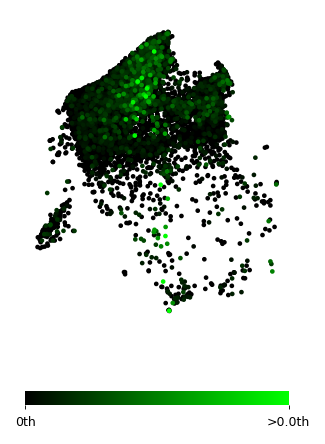

52.711928916932024
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
52.711928916932024
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
52.711928916932024
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
52.711928916932024
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
52.711928916932024
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
19.835767650604854
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


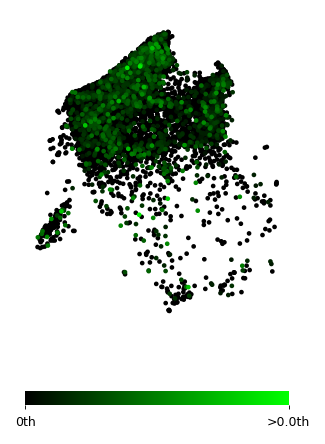

19.835767650604854
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
19.835767650604854
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
19.835767650604854
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
19.835767650604854
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
19.835767650604854
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
118.45135697937546
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


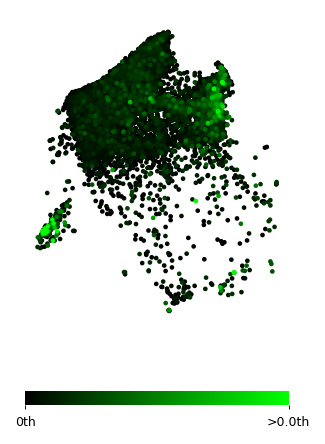

118.45135697937546
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
118.45135697937546
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
118.45135697937546
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
118.45135697937546
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
118.45135697937546
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
176.27942550659205
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


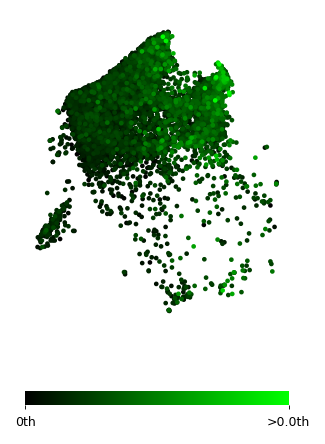

176.27942550659205
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
176.27942550659205
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
176.27942550659205
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
176.27942550659205
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
176.27942550659205
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
470.7489513549947
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


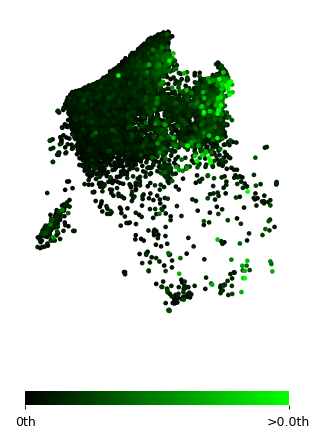

470.7489513549947
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
470.7489513549947
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
470.7489513549947
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
470.7489513549947
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
470.7489513549947
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
90.60394920349142
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


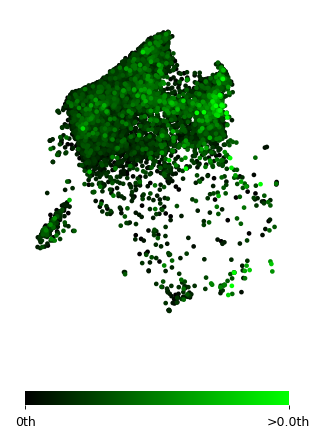

90.60394920349142
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
90.60394920349142
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
90.60394920349142
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
90.60394920349142
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
90.60394920349142
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
210.566749664307
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


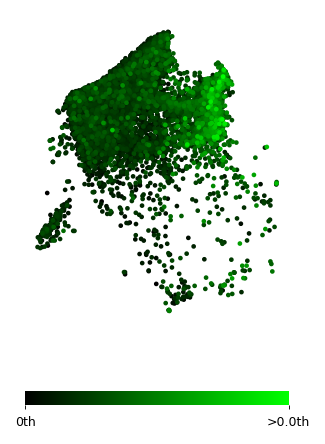

210.566749664307
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
210.566749664307
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
210.566749664307
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
210.566749664307
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
210.566749664307
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
33.265808631897194
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


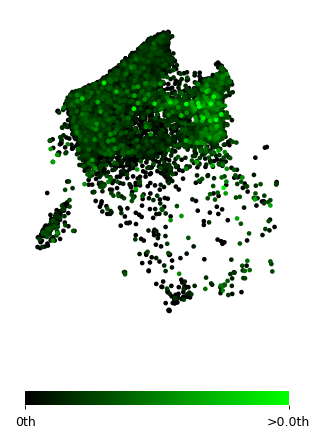

33.265808631897194
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
33.265808631897194
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
33.265808631897194
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
33.265808631897194
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
33.265808631897194
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
40.4040412902832
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


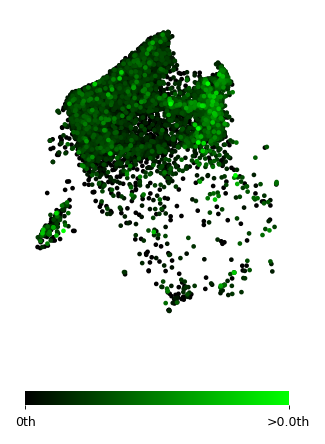

40.4040412902832
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
40.4040412902832
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
40.4040412902832
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
40.4040412902832
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
40.4040412902832
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.024886920929333
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


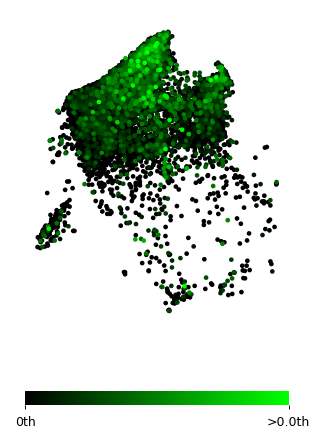

21.024886920929333
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.024886920929333
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.024886920929333
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.024886920929333
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.024886920929333
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1703.5489768066586
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


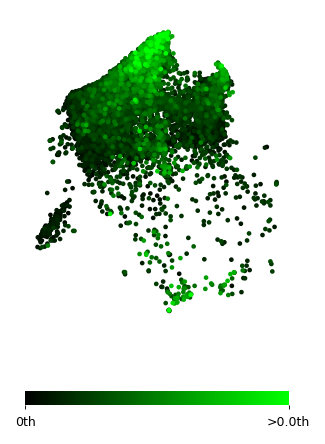

1703.5489768066586
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
1703.5489768066586
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1703.5489768066586
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1703.5489768066586
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1703.5489768066586
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.07554798889208
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


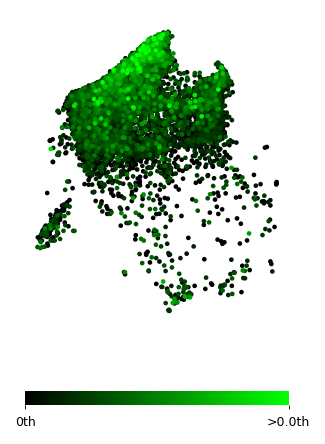

34.07554798889208
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
34.07554798889208
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.07554798889208
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.07554798889208
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.07554798889208
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.85891854858414
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


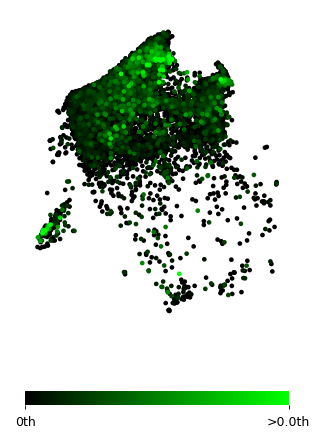

43.85891854858414
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
43.85891854858414
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.85891854858414
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.85891854858414
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.85891854858414
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.1047958488467
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


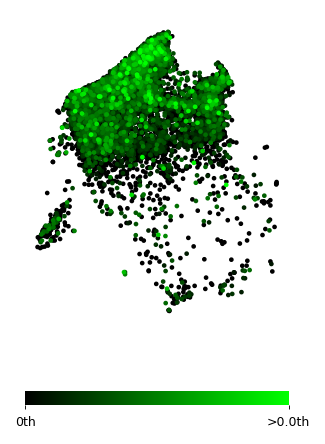

21.1047958488467
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.1047958488467
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.1047958488467
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.1047958488467
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.1047958488467
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.25863159561205
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


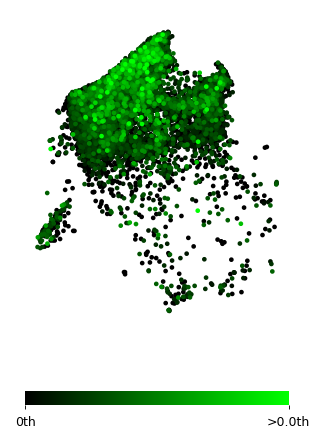

29.25863159561205
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
29.25863159561205
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.25863159561205
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.25863159561205
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.25863159561205
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
42.15731657409694
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


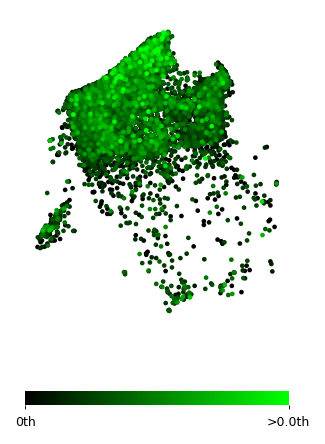

42.15731657409694
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
42.15731657409694
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
42.15731657409694
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
42.15731657409694
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
42.15731657409694
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
41.24191039276168
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


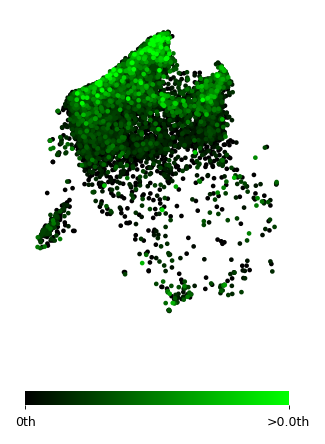

41.24191039276168
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
41.24191039276168
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
41.24191039276168
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
41.24191039276168
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
41.24191039276168
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.826914424896756
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


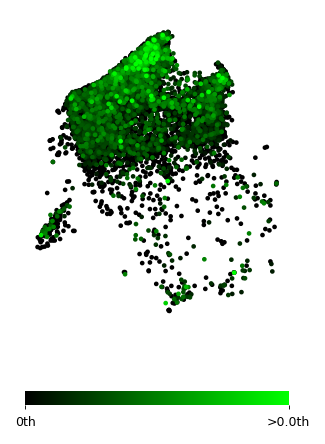

20.826914424896756
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.826914424896756
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.826914424896756
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.826914424896756
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.826914424896756
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
53.85746685791122
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


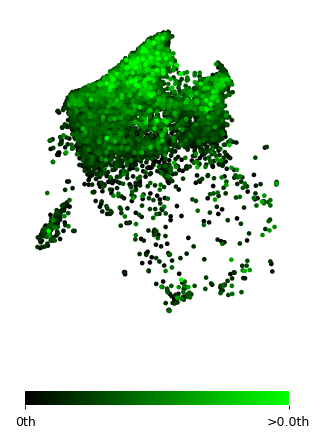

53.85746685791122
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
53.85746685791122
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
53.85746685791122
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
53.85746685791122
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
53.85746685791122
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.45325355529922
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


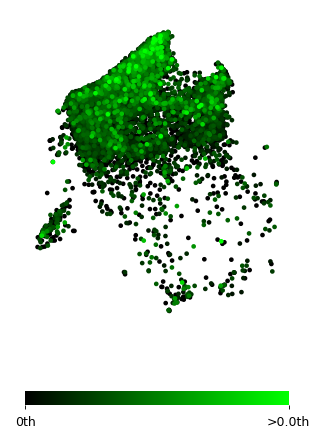

29.45325355529922
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
29.45325355529922
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.45325355529922
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.45325355529922
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.45325355529922
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
26.832082210541127
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


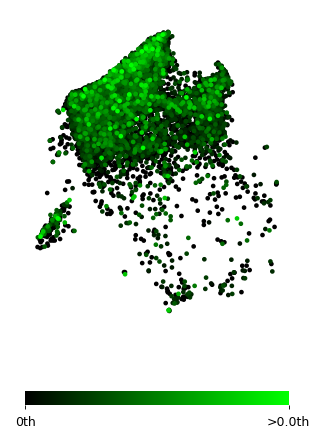

26.832082210541127
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
26.832082210541127
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
26.832082210541127
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
26.832082210541127
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
26.832082210541127
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
28.631437950134583
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


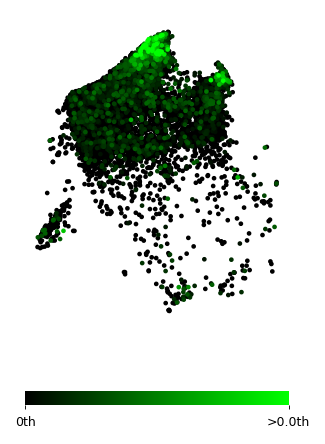

28.631437950134583
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
28.631437950134583
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
28.631437950134583
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
28.631437950134583
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
28.631437950134583
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.84082552719151
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


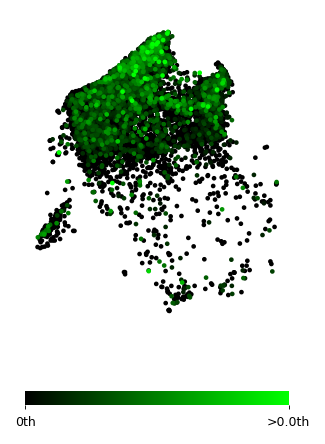

17.84082552719151
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
17.84082552719151
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.84082552719151
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.84082552719151
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.84082552719151
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
81.0067124633826
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


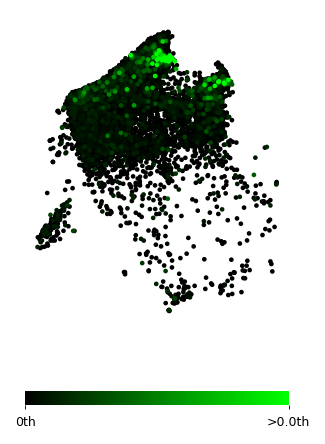

81.0067124633826
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
81.0067124633826
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
81.0067124633826
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
81.0067124633826
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
81.0067124633826
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
24.274078296662957
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


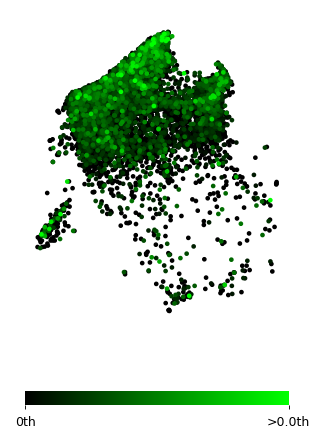

24.274078296662957
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
24.274078296662957
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
24.274078296662957
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
24.274078296662957
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
24.274078296662957
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
30.338977355957212
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


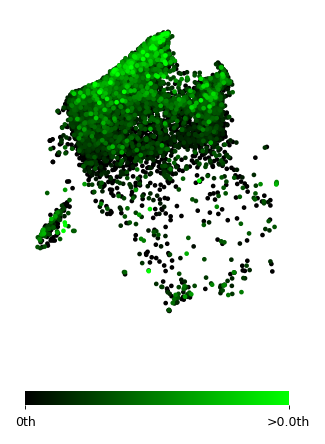

30.338977355957212
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
30.338977355957212
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
30.338977355957212
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
30.338977355957212
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
30.338977355957212
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.99927788162238
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


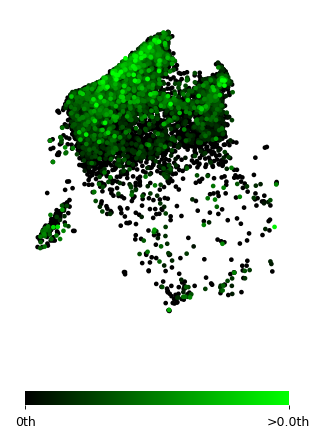

20.99927788162238
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.99927788162238
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.99927788162238
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.99927788162238
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.99927788162238
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
87.28348118591438
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


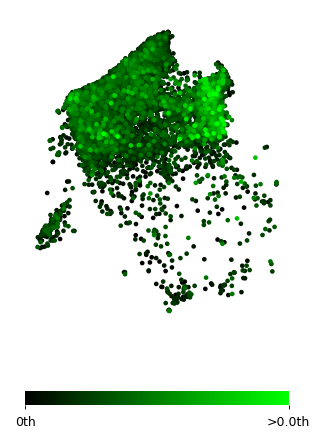

87.28348118591438
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
87.28348118591438
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
87.28348118591438
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
87.28348118591438
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
87.28348118591438
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
68.04131544494811
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


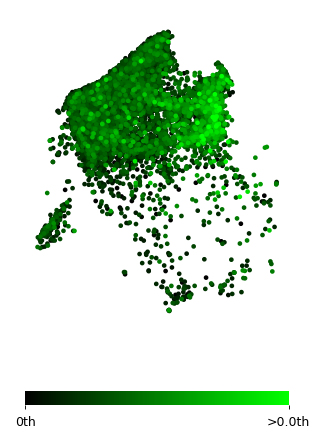

68.04131544494811
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
68.04131544494811
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
68.04131544494811
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
68.04131544494811
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
68.04131544494811
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
44.43661976623571
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


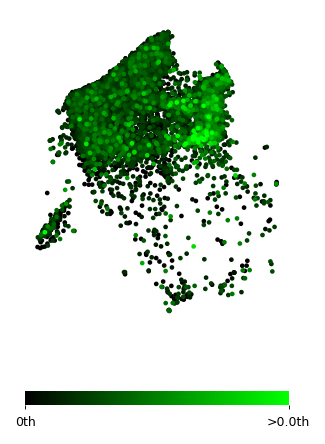

44.43661976623571
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
44.43661976623571
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
44.43661976623571
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
44.43661976623571
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
44.43661976623571
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.268145324707255
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


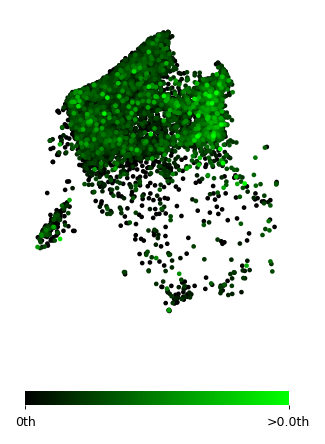

32.268145324707255
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
32.268145324707255
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.268145324707255
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.268145324707255
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.268145324707255
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
112.40043487548951
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


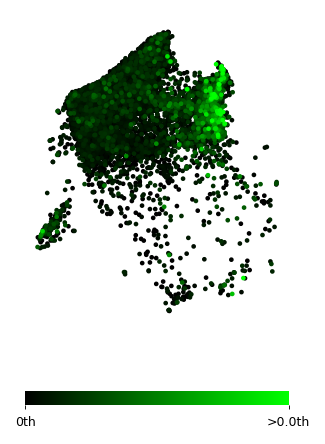

112.40043487548951
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
112.40043487548951
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
112.40043487548951
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
112.40043487548951
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
112.40043487548951
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.388562732697064
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


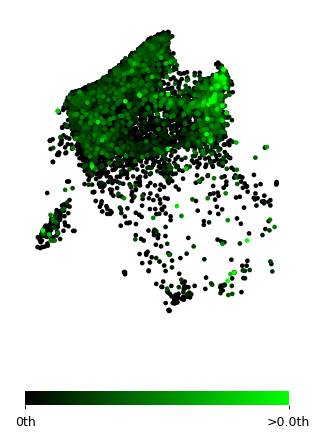

20.388562732697064
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
20.388562732697064
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.388562732697064
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
20.388562732697064
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
20.388562732697064
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
27.59280438995384
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


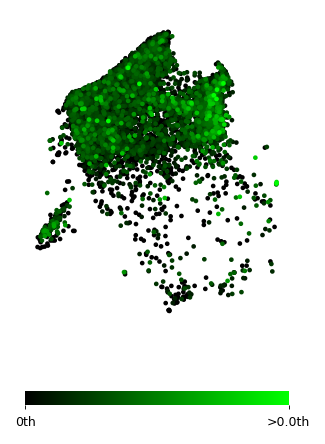

27.59280438995384
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
27.59280438995384
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
27.59280438995384
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
27.59280438995384
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
27.59280438995384
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
104.00686859131052
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


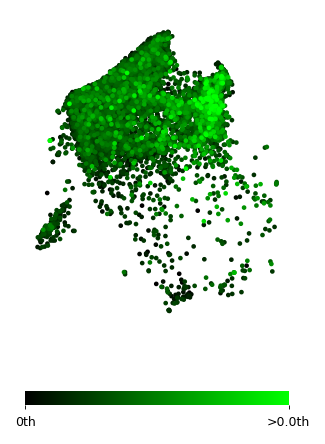

104.00686859131052
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
104.00686859131052
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
104.00686859131052
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
104.00686859131052
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
104.00686859131052
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.11285492706321
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


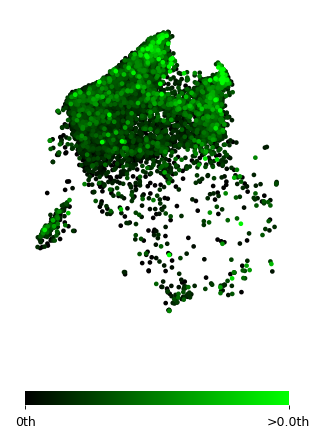

57.11285492706321
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
57.11285492706321
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.11285492706321
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
57.11285492706321
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
57.11285492706321
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
100.1244969787615
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


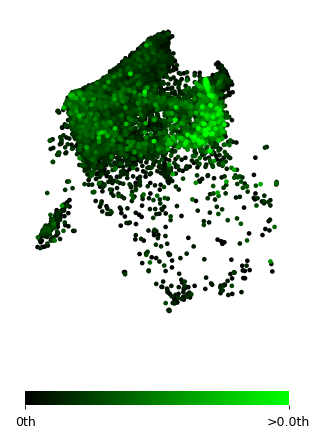

100.1244969787615
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
100.1244969787615
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
100.1244969787615
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
100.1244969787615
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
100.1244969787615
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
80.02713966369839
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


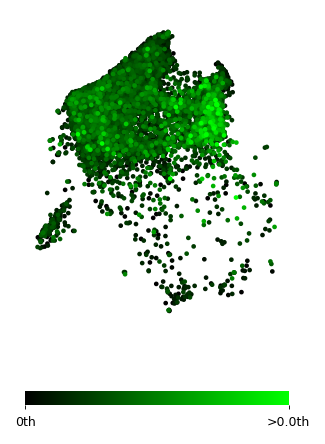

80.02713966369839
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
80.02713966369839
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
80.02713966369839
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
80.02713966369839
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
80.02713966369839
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
52.66483674621669
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


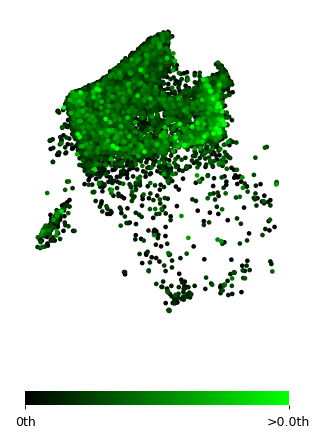

52.66483674621669
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
52.66483674621669
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
52.66483674621669
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
52.66483674621669
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
52.66483674621669
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.872425155640016
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


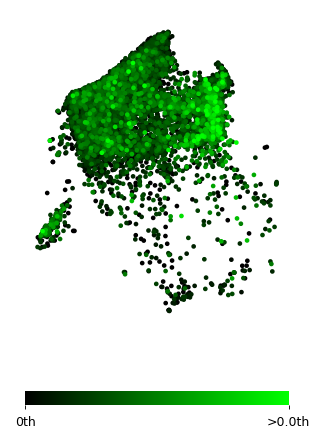

43.872425155640016
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
43.872425155640016
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.872425155640016
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
43.872425155640016
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
43.872425155640016
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
37.63290602874804
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


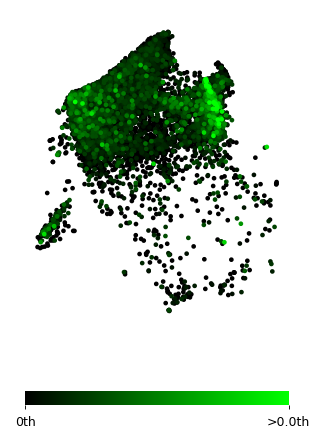

37.63290602874804
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
37.63290602874804
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
37.63290602874804
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
37.63290602874804
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
37.63290602874804
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
22.212011299133373
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


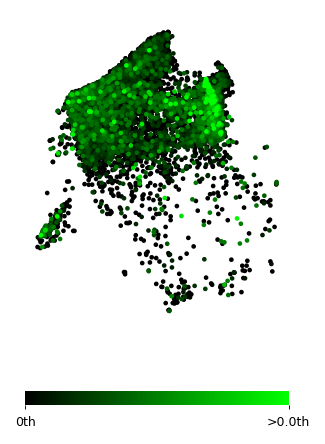

22.212011299133373
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
22.212011299133373
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
22.212011299133373
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
22.212011299133373
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
22.212011299133373
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.320850303650104
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


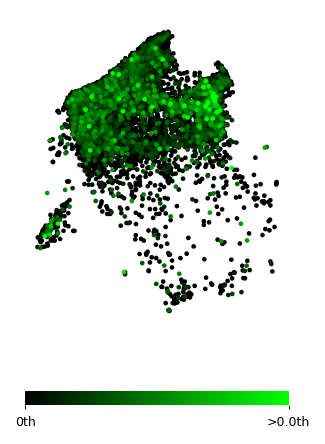

18.320850303650104
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
18.320850303650104
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.320850303650104
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
18.320850303650104
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
18.320850303650104
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.43645784759594
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


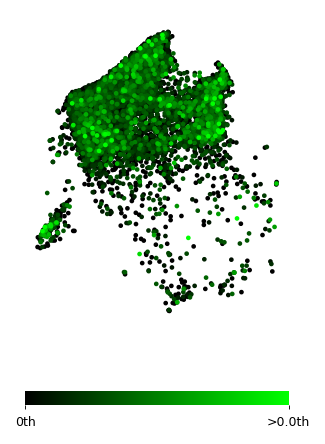

32.43645784759594
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
32.43645784759594
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.43645784759594
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.43645784759594
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.43645784759594
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1003.1414456787206
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


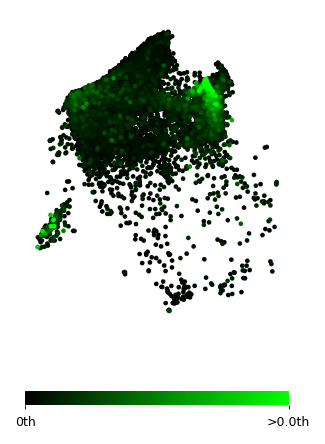

1003.1414456787206
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
1003.1414456787206
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1003.1414456787206
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
1003.1414456787206
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
1003.1414456787206
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.801581291200016
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


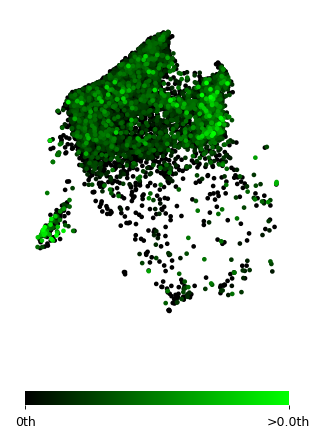

23.801581291200016
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
23.801581291200016
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.801581291200016
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.801581291200016
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.801581291200016
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
46.45367593383796
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


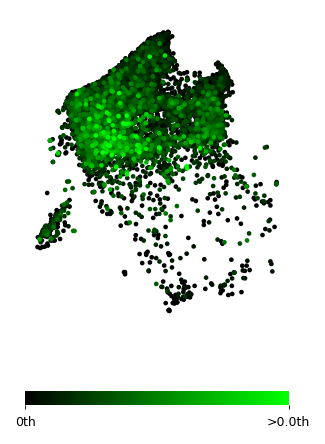

46.45367593383796
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
46.45367593383796
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
46.45367593383796
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
46.45367593383796
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
46.45367593383796
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.47417864227295
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


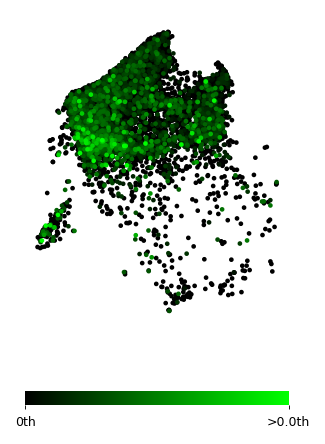

23.47417864227295
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
23.47417864227295
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.47417864227295
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.47417864227295
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.47417864227295
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
61.39056548309523
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


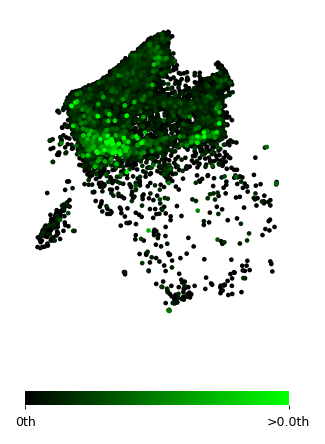

61.39056548309523
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
61.39056548309523
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
61.39056548309523
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
61.39056548309523
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
61.39056548309523
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
27.676399040223266
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


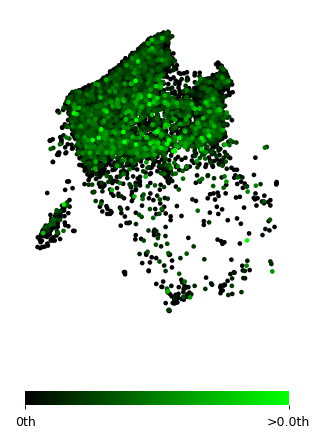

27.676399040223266
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
27.676399040223266
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
27.676399040223266
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
27.676399040223266
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
27.676399040223266
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.057458976745643
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


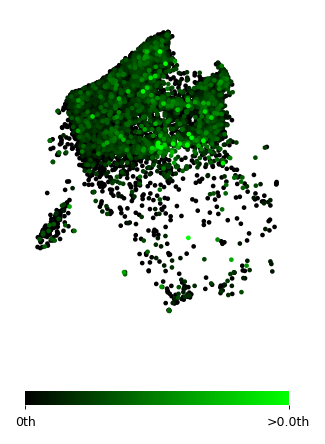

25.057458976745643
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
25.057458976745643
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.057458976745643
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
25.057458976745643
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
25.057458976745643
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
88.86296279907961
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


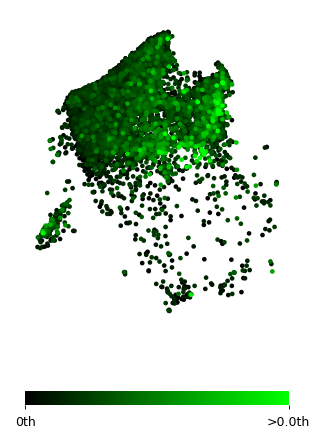

88.86296279907961
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
88.86296279907961
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
88.86296279907961
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
88.86296279907961
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
88.86296279907961
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
106.44070001220732
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


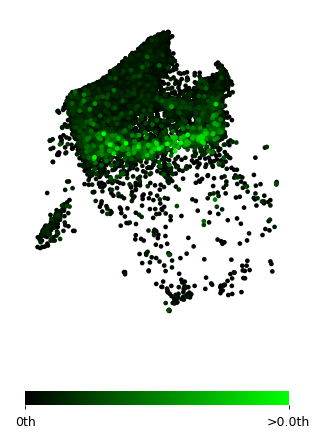

106.44070001220732
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
106.44070001220732
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
106.44070001220732
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
106.44070001220732
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
106.44070001220732
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.873810691834436
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


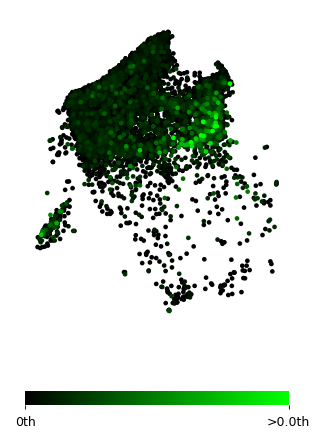

55.873810691834436
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
55.873810691834436
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.873810691834436
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
55.873810691834436
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
55.873810691834436
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
45.8037637557984
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


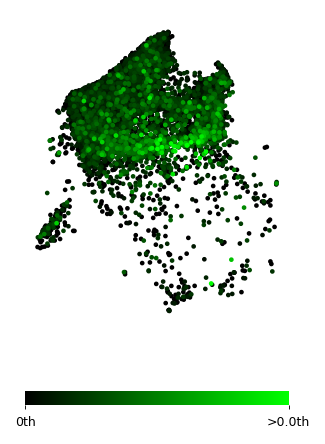

45.8037637557984
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
45.8037637557984
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
45.8037637557984
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
45.8037637557984
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
45.8037637557984
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
72.6170339355479
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


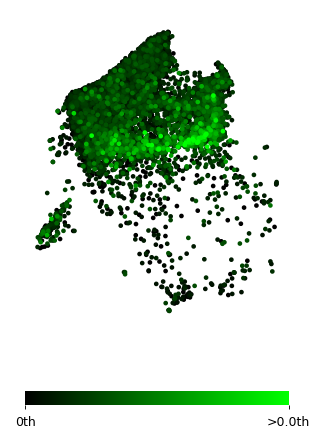

72.6170339355479
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
72.6170339355479
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
72.6170339355479
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
72.6170339355479
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
72.6170339355479
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.30924866485628
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


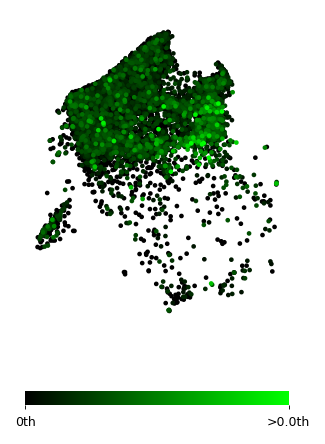

34.30924866485628
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
34.30924866485628
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.30924866485628
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
34.30924866485628
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
34.30924866485628
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
116.37796907043776
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


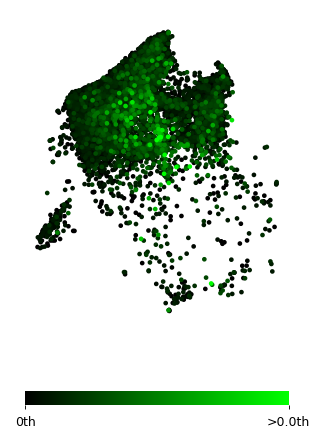

116.37796907043776
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
116.37796907043776
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
116.37796907043776
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
116.37796907043776
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
116.37796907043776
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.15153580474869
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


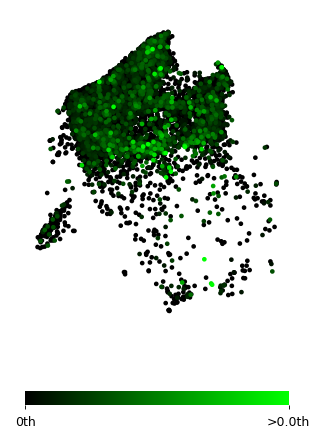

29.15153580474869
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
29.15153580474869
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.15153580474869
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.15153580474869
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.15153580474869
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
19.27375823593152
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


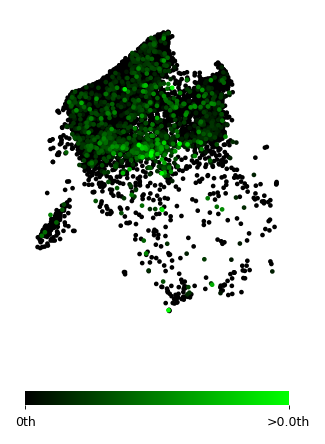

19.27375823593152
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
19.27375823593152
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
19.27375823593152
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
19.27375823593152
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
19.27375823593152
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
51.856898941040086
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


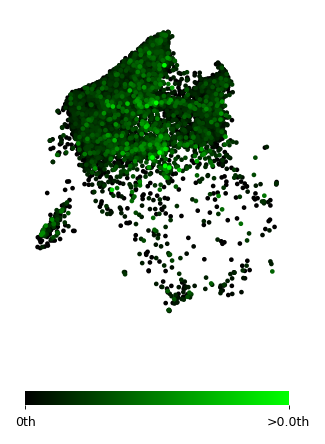

51.856898941040086
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
51.856898941040086
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
51.856898941040086
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
51.856898941040086
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
51.856898941040086
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
47.62107589721752
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


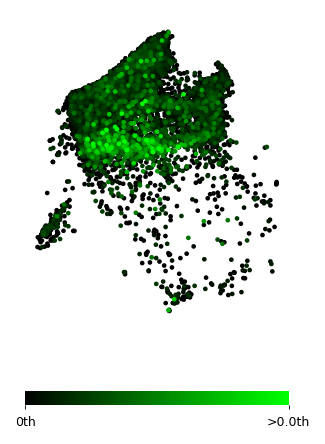

47.62107589721752
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
47.62107589721752
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
47.62107589721752
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
47.62107589721752
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
47.62107589721752
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.493636558533353
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


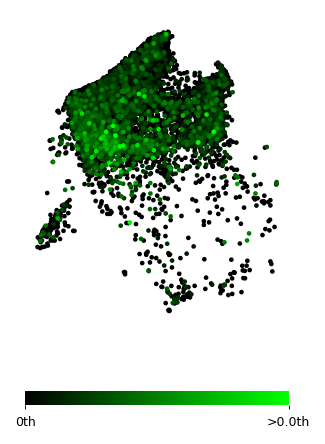

21.493636558533353
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.493636558533353
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.493636558533353
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.493636558533353
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.493636558533353
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.156972698211895
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


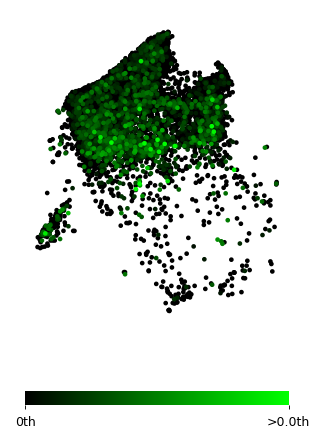

23.156972698211895
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
23.156972698211895
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.156972698211895
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
23.156972698211895
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
23.156972698211895
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
13.390502710342606
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


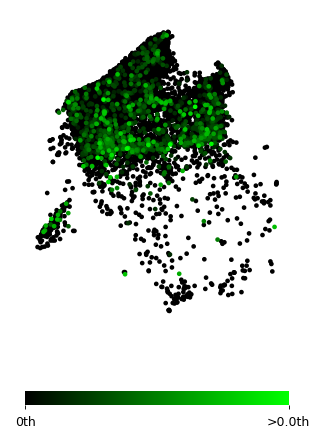

13.390502710342606
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
13.390502710342606
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
13.390502710342606
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
13.390502710342606
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
13.390502710342606
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
48.852802597046065
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


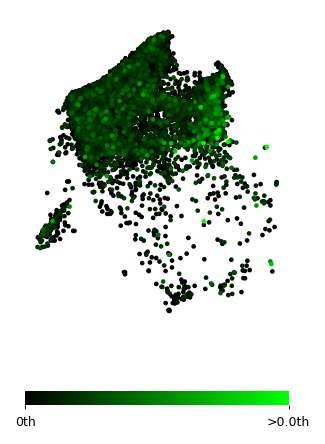

48.852802597046065
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
48.852802597046065
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
48.852802597046065
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
48.852802597046065
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
48.852802597046065
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.408834001541528
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


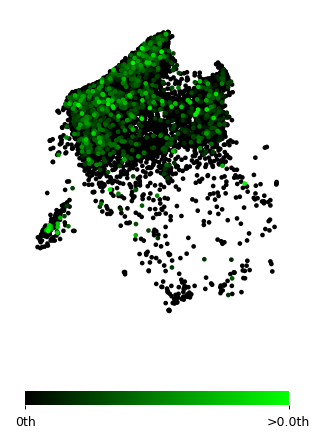

11.408834001541528
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
11.408834001541528
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.408834001541528
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.408834001541528
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.408834001541528
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
14.426883359909304
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


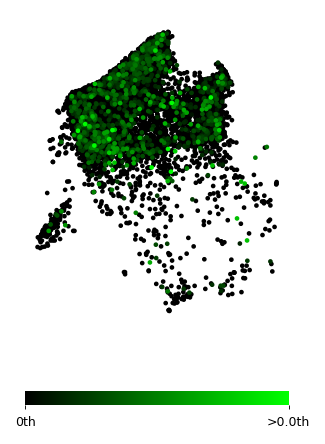

14.426883359909304
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
14.426883359909304
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
14.426883359909304
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
14.426883359909304
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
14.426883359909304
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.039636898040843
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


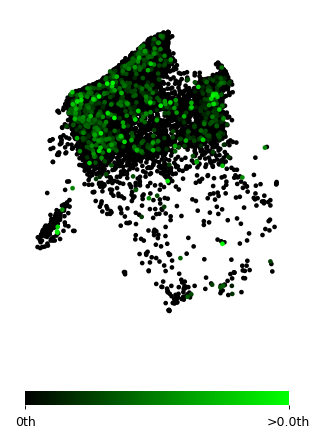

11.039636898040843
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
11.039636898040843
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.039636898040843
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.039636898040843
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.039636898040843
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
16.246093788147167
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


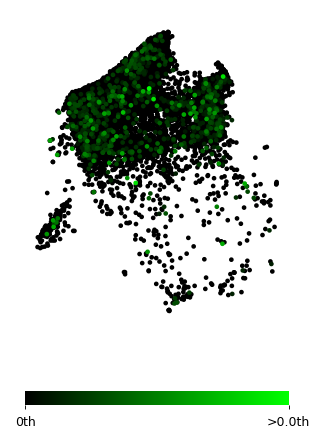

16.246093788147167
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
16.246093788147167
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
16.246093788147167
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
16.246093788147167
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
16.246093788147167
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.724853109359774
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


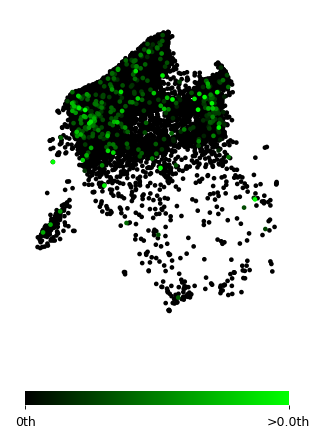

10.724853109359774
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.724853109359774
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.724853109359774
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.724853109359774
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.724853109359774
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.821730361938837
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


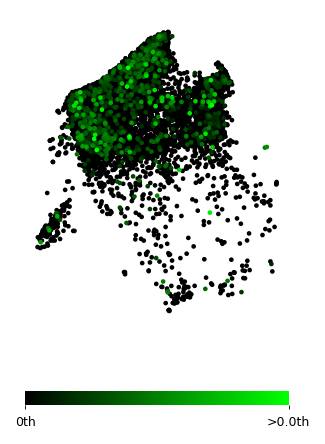

11.821730361938837
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
11.821730361938837
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.821730361938837
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.821730361938837
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.821730361938837
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.39096778106809
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


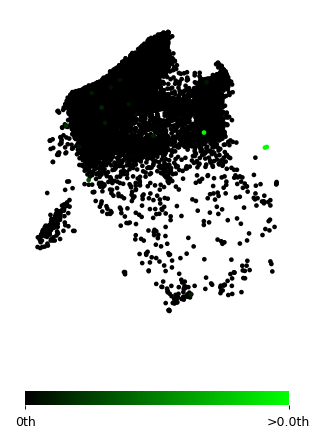

32.39096778106809
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
32.39096778106809
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.39096778106809
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.39096778106809
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.39096778106809
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
7.9524314146043
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


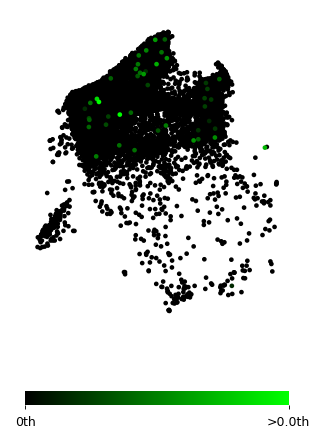

7.9524314146043
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
7.9524314146043
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
7.9524314146043
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
7.9524314146043
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
7.9524314146043
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
5.879696662902976
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


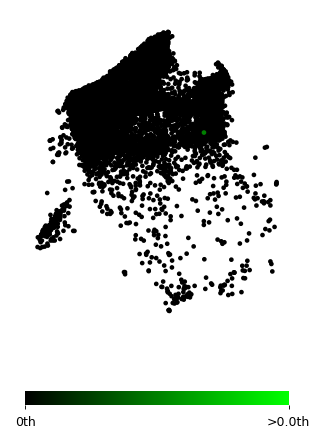

5.879696662902976
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
5.879696662902976
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
5.879696662902976
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
5.879696662902976
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
5.879696662902976
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
7.573072331429172
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


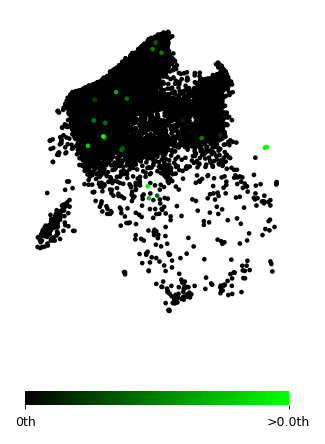

7.573072331429172
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
7.573072331429172
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
7.573072331429172
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
7.573072331429172
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
7.573072331429172
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
6.173555681228852
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


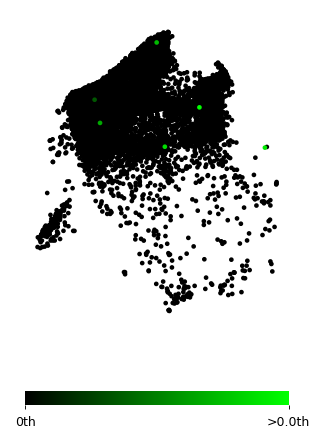

6.173555681228852
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
6.173555681228852
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
6.173555681228852
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
6.173555681228852
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
6.173555681228852
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.747906564712558
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


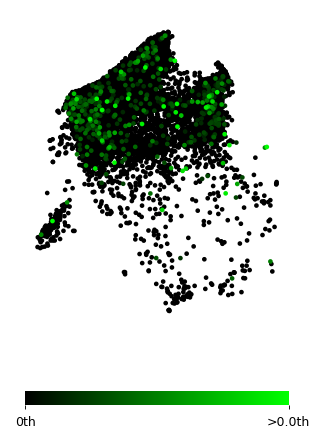

10.747906564712558
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.747906564712558
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.747906564712558
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.747906564712558
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.747906564712558
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.883442451477121
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


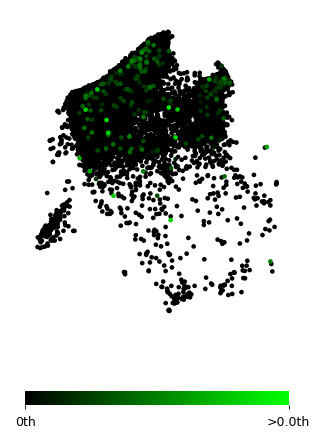

10.883442451477121
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.883442451477121
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.883442451477121
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.883442451477121
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.883442451477121
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.17045908546457
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


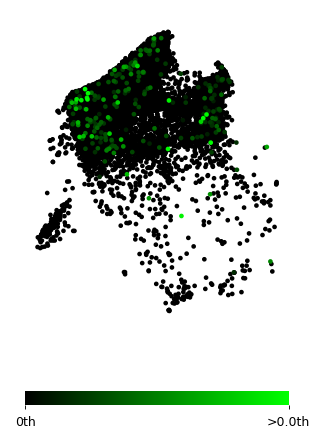

10.17045908546457
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.17045908546457
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.17045908546457
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.17045908546457
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.17045908546457
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.534746849060156
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


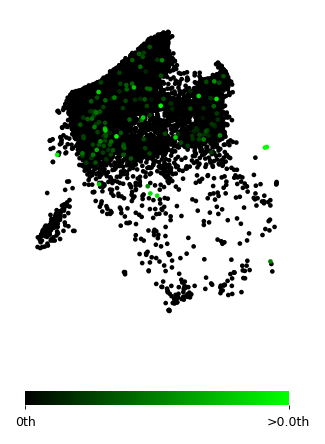

10.534746849060156
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.534746849060156
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.534746849060156
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.534746849060156
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.534746849060156
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.613010982513527
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


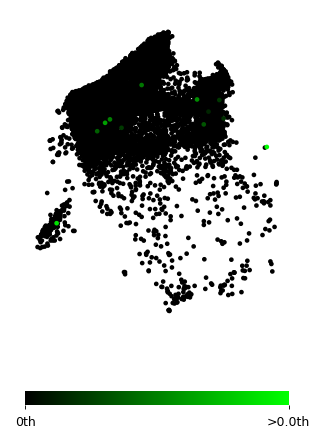

10.613010982513527
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.613010982513527
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.613010982513527
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.613010982513527
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.613010982513527
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.431105037689392
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


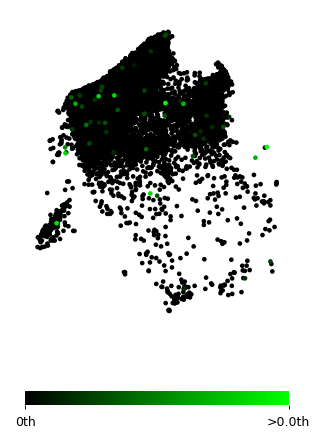

10.431105037689392
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
10.431105037689392
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.431105037689392
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
10.431105037689392
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
10.431105037689392
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.43041770553591
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


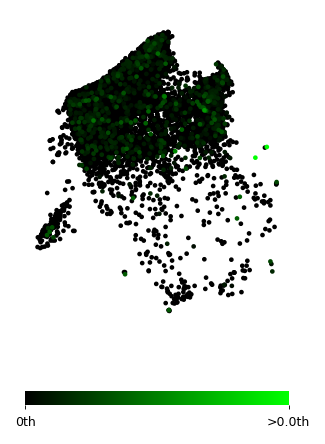

29.43041770553591
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
29.43041770553591
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.43041770553591
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
29.43041770553591
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
29.43041770553591
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.049724578857422
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


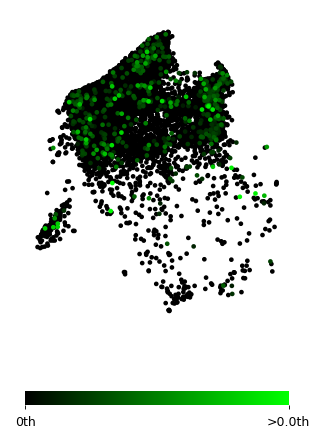

11.049724578857422
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
11.049724578857422
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.049724578857422
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
11.049724578857422
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
11.049724578857422
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.36942691803145
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


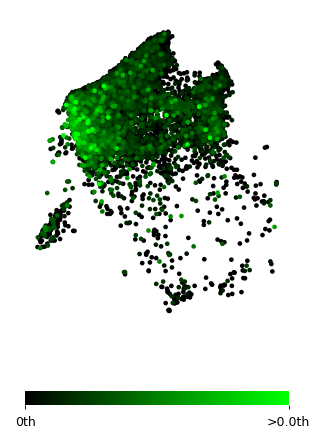

32.36942691803145
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
32.36942691803145
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.36942691803145
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
32.36942691803145
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
32.36942691803145
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.635332988739084
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


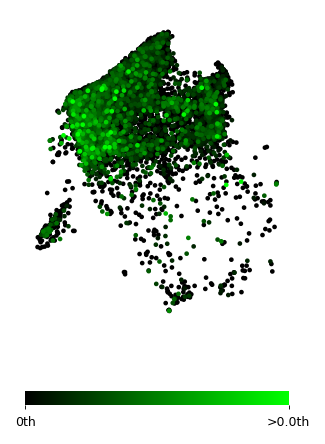

21.635332988739084
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.635332988739084
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.635332988739084
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.635332988739084
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.635332988739084
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
285.99775500488744
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


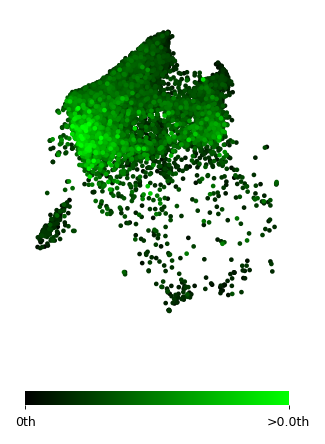

285.99775500488744
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
285.99775500488744
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
285.99775500488744
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
285.99775500488744
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
285.99775500488744
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
73.62194677734531
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


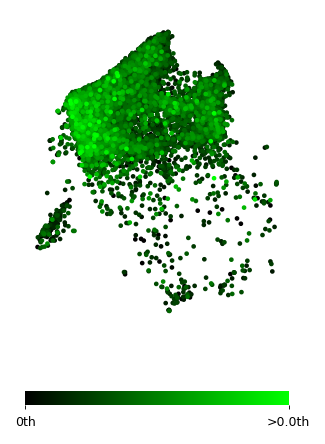

73.62194677734531
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
73.62194677734531
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
73.62194677734531
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
73.62194677734531
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
73.62194677734531
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
106.88660023498548
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


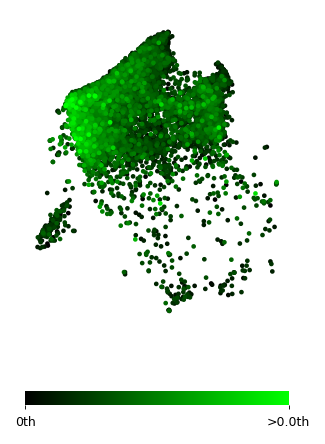

106.88660023498548
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
106.88660023498548
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
106.88660023498548
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
106.88660023498548
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
106.88660023498548
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
70.39082122802773
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


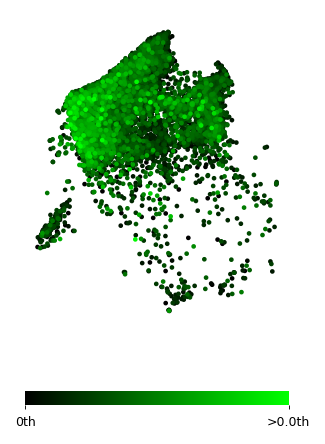

70.39082122802773
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
70.39082122802773
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
70.39082122802773
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
70.39082122802773
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
70.39082122802773
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
124.57816915893633
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


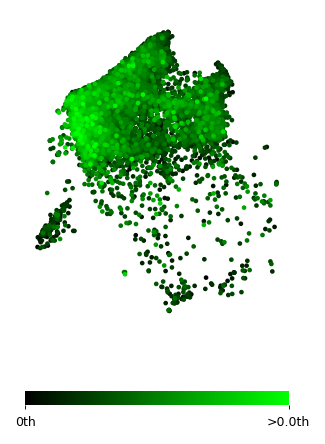

124.57816915893633
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
124.57816915893633
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
124.57816915893633
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
124.57816915893633
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
124.57816915893633
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
131.58547741699311
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


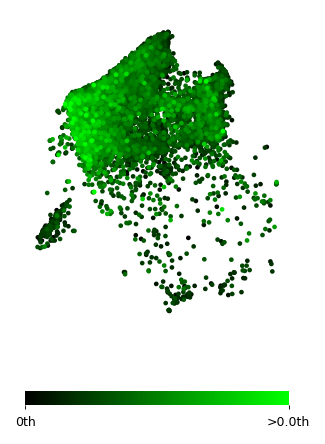

131.58547741699311
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
131.58547741699311
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
131.58547741699311
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
131.58547741699311
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
131.58547741699311
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
67.24235652160682
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


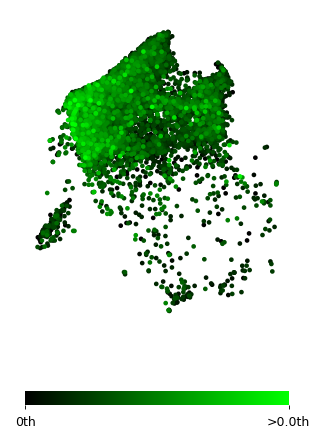

67.24235652160682
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
67.24235652160682
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
67.24235652160682
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
67.24235652160682
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
67.24235652160682
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
75.59865391540617
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


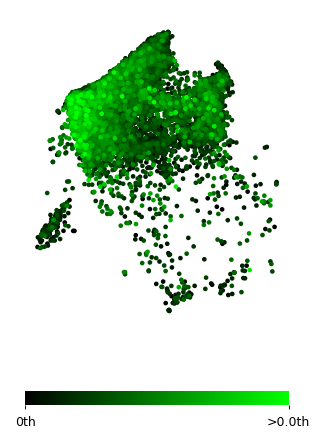

75.59865391540617
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
75.59865391540617
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
75.59865391540617
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
75.59865391540617
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
75.59865391540617
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
278.8449783325208
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


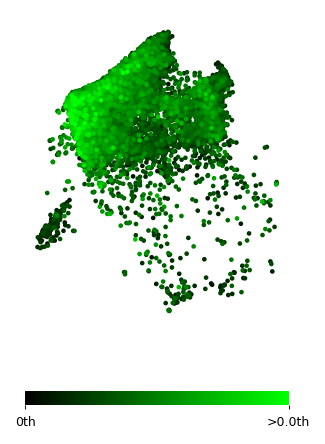

278.8449783325208
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
278.8449783325208
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
278.8449783325208
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
278.8449783325208
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
278.8449783325208
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
253.2957016601569
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


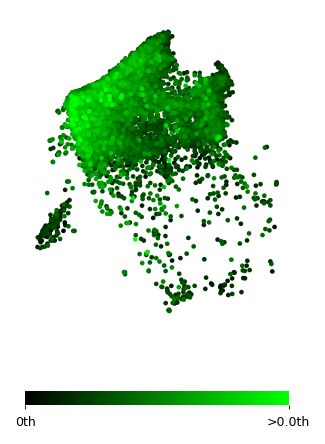

253.2957016601569
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
253.2957016601569
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
253.2957016601569
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
253.2957016601569
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
253.2957016601569
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
425.9922542114632
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


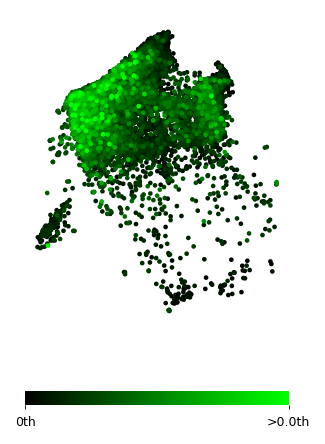

425.9922542114632
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
425.9922542114632
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
425.9922542114632
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
425.9922542114632
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
425.9922542114632
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
137.5362879943863
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


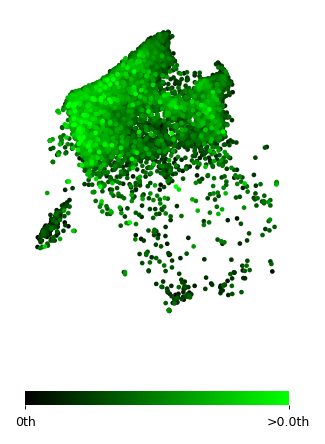

137.5362879943863
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
137.5362879943863
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
137.5362879943863
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
137.5362879943863
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
137.5362879943863
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.972302173615887
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


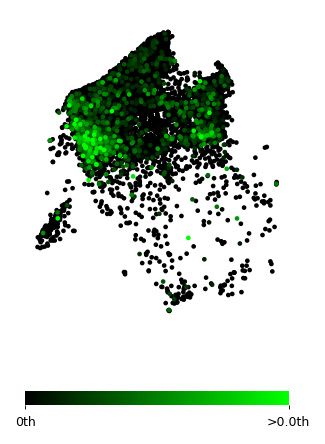

17.972302173615887
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
17.972302173615887
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.972302173615887
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
17.972302173615887
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
17.972302173615887
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
41.635378631592786
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


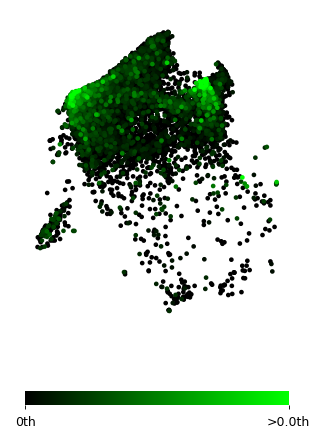

41.635378631592786
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
41.635378631592786
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
41.635378631592786
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
41.635378631592786
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
41.635378631592786
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.307154529571804
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2


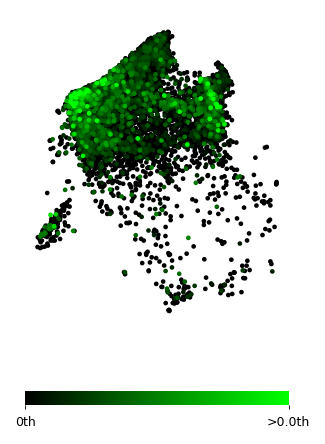

21.307154529571804
-1128.3455667542416 724.3488167542413 -1082.5271627457282 1173.4962627457282 x1x2y1y2
21.307154529571804
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.307154529571804
-1140.9577292542413 721.2398292542414 -1084.001052745728 1165.646552745728 x1x2y1y2
21.307154529571804
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2
21.307154529571804
-1122.3391572542412 709.9104172542413 -1076.3130527457279 1182.339152745728 x1x2y1y2


In [31]:
genes = inheat

ftypes = ['png','pdf']
pctilemax = 99.9

!mkdir -p postannotoutputs/umapbygenebycond

for gene in genes:
    
    gmask = adata.var_names == gene
    expression = adata.X[cmask][:,gmask].toarray().T[0]
    vmax = np.percentile(expression,pctilemax)
    
    show=True
    
    !mkdir -p postannotoutputs/umapbygenebycond/$gene
    
    for cond in adata.obs['condition'].unique():
        condmask = adata.obs['condition'] == cond
        condmask = condmask.values
    
        for ftype in ftypes:        
            spring_like(
                    gene,
                    expression[condmask],
                    x[condmask],
                    y[condmask],
                    printlims=True,
                    box = [0,0,1,1],
                    s = 5,
                    vmax=vmax,
                    w = 5,
                    h = 7.5,
                    comment = cond,
                    pad = 0,
                    ftype = ftype,
                    dpi = 1200.,
                    show_cbar=True,
                    lims = [-1130,-1085,725,1183],
                    save=True,
                    show=show,
                    outputdir='postannotoutputs/umapbygenebycond/'+gene+'/'
                    )
            show=False

In [73]:
!open postannotoutputs/